<a href="https://colab.research.google.com/github/SolankiAcharya/Batch-1844-DATA-TRAINED-/blob/main/Rainfall_Prediction_Weather_Forecasting.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Problem Statement:


Rain Prediction –Weather forecasting

Weather forecasting is the application of science and technology to predict the conditions of the atmosphere for a given location and time. Weather forecasts are made by collecting quantitative data about the current state of the atmosphere at a given place and using meteorology to project how the atmosphere will change.

Rain Dataset is to predict whether or not it will rain tomorrow. The Dataset contains about 10 years of daily weather observations of different locations in Australia. 

Here, we have to predict two things:

1. To design a predictive model with the use of machine learning algorithms to forecast whether or not it will rain tomorrow.

2. To design a predictive model with the use of machine learning algorithms to predict how much rainfall could be there.


Dataset Description:

Number of columns: 23


Date  - The date of observation

Location  -The common name of the location of the weather station

MinTemp  -The minimum temperature in degrees celsius

MaxTemp -The maximum temperature in degrees celsius

Rainfall  -The amount of rainfall recorded for the day in mm

Evaporation  -The so-called Class A pan evaporation (mm) in the 24 hours to 9am

Sunshine  -The number of hours of bright sunshine in the day.

WindGustDi r- The direction of the strongest wind gust in the 24 hours to midnight

WindGustSpeed -The speed (km/h) of the strongest wind gust in the 24 hours to midnight

WindDir9am -Direction of the wind at 9am

WindDir3pm -Direction of the wind at 3pm

WindSpeed9am -Wind speed (km/hr) averaged over 10 minutes prior to 9am

WindSpeed3pm -Wind speed (km/hr) averaged over 10 minutes prior to 3pm

Humidity9am -Humidity (percent) at 9am

Humidity3pm -Humidity (percent) at 3pm

Pressure9am -Atmospheric pressure (hpa) reduced to mean sea level at 9am

Pressure3pm -Atmospheric pressure (hpa) reduced to mean sea level at 3pm

Cloud9am - Fraction of sky obscured by cloud at 9am. 

Cloud3pm -Fraction of sky obscured by cloud 

Temp9am-Temperature (degrees C) at 9am

Temp3pm -Temperature (degrees C) at 3pm

RainToday -Boolean: 1 if precipitation (mm) in the 24 hours to 9am exceeds 1mm, otherwise 0

RainTomorrow -The amount of next day rain in mm. Used to create response variable . A kind of measure of the "risk".

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import warnings 
warnings.simplefilter("ignore")
warnings.filterwarnings("ignore")

In [ ]:
df = pd.read_csv('https://raw.githubusercontent.com/dsrscientist/dataset3/main/weatherAUS.csv')
df

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,...,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No
8421,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,...,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No
8422,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,...,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No
8423,2017-06-24,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,...,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No


In [ ]:
df.shape

(8425, 23)

In [ ]:
# Here we have two target columns:-
# 1. RainTomorrow: This column has 2 values Yes and No. Hence, it is a binary classification problem.
# 2. Rainfall: This column contains values of continuous numeric nature. So, this one is a regression problem.

In [ ]:
df.isnull().sum()

Date                0
Location            0
MinTemp            75
MaxTemp            60
Rainfall          240
Evaporation      3512
Sunshine         3994
WindGustDir       991
WindGustSpeed     991
WindDir9am        829
WindDir3pm        308
WindSpeed9am       76
WindSpeed3pm      107
Humidity9am        59
Humidity3pm       102
Pressure9am      1309
Pressure3pm      1312
Cloud9am         2421
Cloud3pm         2455
Temp9am            56
Temp3pm            96
RainToday         240
RainTomorrow      239
dtype: int64

In [ ]:
df.dtypes

Date              object
Location          object
MinTemp          float64
MaxTemp          float64
Rainfall         float64
Evaporation      float64
Sunshine         float64
WindGustDir       object
WindGustSpeed    float64
WindDir9am        object
WindDir3pm        object
WindSpeed9am     float64
WindSpeed3pm     float64
Humidity9am      float64
Humidity3pm      float64
Pressure9am      float64
Pressure3pm      float64
Cloud9am         float64
Cloud3pm         float64
Temp9am          float64
Temp3pm          float64
RainToday         object
RainTomorrow      object
dtype: object

In [ ]:
# 16 features are of float data types
# 9 features are of object data types

In [ ]:
# list. of object data types:

object_datatypes=[]
for x in df.dtypes.index:
    if df.dtypes[x]=='object':
        object_datatypes.append(x)
object_datatypes

['Date',
 'Location',
 'WindGustDir',
 'WindDir9am',
 'WindDir3pm',
 'RainToday',
 'RainTomorrow']

In [ ]:
# list of numerical data types:

numerical_datatypes=[]
for x in df.dtypes.index:
    if df.dtypes[x]!= 'object':
      numerical_datatypes.append(x)
numerical_datatypes

['MinTemp',
 'MaxTemp',
 'Rainfall',
 'Evaporation',
 'Sunshine',
 'WindGustSpeed',
 'WindSpeed9am',
 'WindSpeed3pm',
 'Humidity9am',
 'Humidity3pm',
 'Pressure9am',
 'Pressure3pm',
 'Cloud9am',
 'Cloud3pm',
 'Temp9am',
 'Temp3pm']

In [ ]:
df.skew()

MinTemp          -0.089588
MaxTemp           0.379297
Rainfall         13.028837
Evaporation      10.710605
Sunshine         -0.519717
WindGustSpeed     0.711103
WindSpeed9am      0.956250
WindSpeed3pm      0.491069
Humidity9am      -0.255843
Humidity3pm       0.117563
Pressure9am      -0.022133
Pressure3pm      -0.009385
Cloud9am         -0.309417
Cloud3pm         -0.232598
Temp9am          -0.014699
Temp3pm           0.395061
dtype: float64

In [ ]:
# We have skewness present in Rainfall, Evaporation, Sunshine, WindGustSpeed and WindSpeed9am.
# So, we should replace the NaN values with median in order to achieve the maximum accuracy

In [ ]:
# fill up or replace the null

In [ ]:
df[object_datatypes].isnull().sum()

Date              0
Location          0
WindGustDir     991
WindDir9am      829
WindDir3pm      308
RainToday       240
RainTomorrow    239
dtype: int64

In [ ]:
# Replacing null values in categorical column with mode()

df["WindGustDir"] = df["WindGustDir"].fillna(df["WindGustDir"].mode()[0])
df["WindDir9am"] = df["WindDir9am"].fillna(df["WindDir9am"].mode()[0])
df["WindDir3pm"] = df["WindDir3pm"].fillna(df["WindDir3pm"].mode()[0])
df["RainToday"] = df["RainToday"].fillna(df["RainToday"].mode()[0])
df["RainTomorrow"] = df["RainTomorrow"].fillna(df["RainTomorrow"].mode()[0])

In [ ]:
df[numerical_datatypes].isnull().sum()

MinTemp            75
MaxTemp            60
Rainfall          240
Evaporation      3512
Sunshine         3994
WindGustSpeed     991
WindSpeed9am       76
WindSpeed3pm      107
Humidity9am        59
Humidity3pm       102
Pressure9am      1309
Pressure3pm      1312
Cloud9am         2421
Cloud3pm         2455
Temp9am            56
Temp3pm            96
dtype: int64

In [ ]:
# Replacing nan values in numerical columns having skewness with MEDIAN

df["Rainfall"] = df["Rainfall"].fillna(df["Rainfall"].median())
df["Evaporation"] = df["Evaporation"].fillna(df["Evaporation"].median())
df["Sunshine"] = df["Sunshine"].fillna(df["Sunshine"].median())
df["WindGustSpeed"] = df["WindGustSpeed"].fillna(df["WindGustSpeed"].median())
df["WindSpeed9am"] = df["WindSpeed9am"].fillna(df["WindSpeed9am"].median())

In [ ]:
#Replacing nan values in numerical columns without skewness with MEAN

df["MinTemp"] = df["MinTemp"].fillna(df["MinTemp"].mean())
df["MaxTemp"] = df["MaxTemp"].fillna(df["MaxTemp"].mean())
df["WindSpeed3pm"] = df["WindSpeed3pm"].fillna(df["WindSpeed3pm"].mean())
df["Humidity9am"] = df["Humidity9am"].fillna(df["Humidity9am"].mean())
df["Humidity3pm"] = df["Humidity3pm"].fillna(df["Humidity3pm"].mean())
df["Pressure9am"] = df["Pressure9am"].fillna(df["Pressure9am"].mean())
df["Pressure3pm"] = df["Pressure3pm"].fillna(df["Pressure3pm"].mean())
df["Cloud9am"] = df["Cloud9am"].fillna(df["Cloud9am"].mean())
df["Cloud3pm"] = df["Cloud3pm"].fillna(df["Cloud3pm"].mean())
df["Temp9am"] = df["Temp9am"].fillna(df["Temp9am"].mean())
df["Temp3pm"] = df["Temp3pm"].fillna(df["Temp3pm"].mean())

In [ ]:
df.isnull().sum()

Date             0
Location         0
MinTemp          0
MaxTemp          0
Rainfall         0
Evaporation      0
Sunshine         0
WindGustDir      0
WindGustSpeed    0
WindDir9am       0
WindDir3pm       0
WindSpeed9am     0
WindSpeed3pm     0
Humidity9am      0
Humidity3pm      0
Pressure9am      0
Pressure3pm      0
Cloud9am         0
Cloud3pm         0
Temp9am          0
Temp3pm          0
RainToday        0
RainTomorrow     0
dtype: int64

In [ ]:
# We can see there no null values so we are good to proceed further!

In [ ]:
df

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.900000,0.6,4.6,8.7,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.000000,4.503183,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.100000,0.0,4.6,8.7,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,4.566622,4.503183,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.700000,0.0,4.6,8.7,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,4.566622,2.000000,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.000000,0.0,4.6,8.7,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,4.566622,4.503183,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.300000,1.0,4.6,8.7,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.000000,8.000000,17.8,29.7,No,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,2017-06-21,Uluru,2.8,23.400000,0.0,4.6,8.7,E,31.0,SE,...,51.0,24.0,1024.6,1020.3,4.566622,4.503183,10.1,22.4,No,No
8421,2017-06-22,Uluru,3.6,25.300000,0.0,4.6,8.7,NNW,22.0,SE,...,56.0,21.0,1023.5,1019.1,4.566622,4.503183,10.9,24.5,No,No
8422,2017-06-23,Uluru,5.4,26.900000,0.0,4.6,8.7,N,37.0,SE,...,53.0,24.0,1021.0,1016.8,4.566622,4.503183,12.5,26.1,No,No
8423,2017-06-24,Uluru,7.8,27.000000,0.0,4.6,8.7,SE,28.0,SSE,...,51.0,24.0,1019.4,1016.5,3.000000,2.000000,15.1,26.0,No,No


In [ ]:
# Feature Engineering

In [ ]:
# We can see date is in not well known format. So we can change it to Day, Month and Year separately...

In [ ]:
import datetime as dt
df["Date"]=pd.to_datetime(df["Date"])

In [ ]:
#Extracting Year, month and date from Date column

df["Year"]=df["Date"].dt.year
df["Month"]=df["Date"].dt.month
df["Day"]=df["Date"].dt.day

In [ ]:
df

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Year,Month,Day
0,2008-12-01,Albury,13.4,22.900000,0.6,4.6,8.7,W,44.0,W,...,1007.1,8.000000,4.503183,16.9,21.8,No,No,2008,12,1
1,2008-12-02,Albury,7.4,25.100000,0.0,4.6,8.7,WNW,44.0,NNW,...,1007.8,4.566622,4.503183,17.2,24.3,No,No,2008,12,2
2,2008-12-03,Albury,12.9,25.700000,0.0,4.6,8.7,WSW,46.0,W,...,1008.7,4.566622,2.000000,21.0,23.2,No,No,2008,12,3
3,2008-12-04,Albury,9.2,28.000000,0.0,4.6,8.7,NE,24.0,SE,...,1012.8,4.566622,4.503183,18.1,26.5,No,No,2008,12,4
4,2008-12-05,Albury,17.5,32.300000,1.0,4.6,8.7,W,41.0,ENE,...,1006.0,7.000000,8.000000,17.8,29.7,No,No,2008,12,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,2017-06-21,Uluru,2.8,23.400000,0.0,4.6,8.7,E,31.0,SE,...,1020.3,4.566622,4.503183,10.1,22.4,No,No,2017,6,21
8421,2017-06-22,Uluru,3.6,25.300000,0.0,4.6,8.7,NNW,22.0,SE,...,1019.1,4.566622,4.503183,10.9,24.5,No,No,2017,6,22
8422,2017-06-23,Uluru,5.4,26.900000,0.0,4.6,8.7,N,37.0,SE,...,1016.8,4.566622,4.503183,12.5,26.1,No,No,2017,6,23
8423,2017-06-24,Uluru,7.8,27.000000,0.0,4.6,8.7,SE,28.0,SSE,...,1016.5,3.000000,2.000000,15.1,26.0,No,No,2017,6,24


In [ ]:
#lets drop Date column

df = df.drop(["Date"],axis=1)

In [ ]:
df

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Year,Month,Day
0,Albury,13.4,22.900000,0.6,4.6,8.7,W,44.0,W,WNW,...,1007.1,8.000000,4.503183,16.9,21.8,No,No,2008,12,1
1,Albury,7.4,25.100000,0.0,4.6,8.7,WNW,44.0,NNW,WSW,...,1007.8,4.566622,4.503183,17.2,24.3,No,No,2008,12,2
2,Albury,12.9,25.700000,0.0,4.6,8.7,WSW,46.0,W,WSW,...,1008.7,4.566622,2.000000,21.0,23.2,No,No,2008,12,3
3,Albury,9.2,28.000000,0.0,4.6,8.7,NE,24.0,SE,E,...,1012.8,4.566622,4.503183,18.1,26.5,No,No,2008,12,4
4,Albury,17.5,32.300000,1.0,4.6,8.7,W,41.0,ENE,NW,...,1006.0,7.000000,8.000000,17.8,29.7,No,No,2008,12,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,Uluru,2.8,23.400000,0.0,4.6,8.7,E,31.0,SE,ENE,...,1020.3,4.566622,4.503183,10.1,22.4,No,No,2017,6,21
8421,Uluru,3.6,25.300000,0.0,4.6,8.7,NNW,22.0,SE,N,...,1019.1,4.566622,4.503183,10.9,24.5,No,No,2017,6,22
8422,Uluru,5.4,26.900000,0.0,4.6,8.7,N,37.0,SE,WNW,...,1016.8,4.566622,4.503183,12.5,26.1,No,No,2017,6,23
8423,Uluru,7.8,27.000000,0.0,4.6,8.7,SE,28.0,SSE,N,...,1016.5,3.000000,2.000000,15.1,26.0,No,No,2017,6,24


In [ ]:
df.nunique().to_frame("Unique values")

,Unique values
Location,12
MinTemp,286
MaxTemp,332
Rainfall,250
Evaporation,116
Sunshine,140
WindGustDir,16
WindGustSpeed,52
WindDir9am,16
WindDir3pm,16


In [ ]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
MinTemp,8425.0,13.193305,5.379488,-2.0,9.3,13.200000,17.3,28.5
MaxTemp,8425.0,23.859976,6.114516,8.2,19.3,23.300000,28.0,45.5
Rainfall,8425.0,2.725982,10.319872,0.0,0.0,0.000000,0.8,371.0
Evaporation,8425.0,5.060332,3.871619,0.0,4.0,4.600000,5.2,145.0
Sunshine,8425.0,8.138409,2.875324,0.0,8.4,8.700000,8.9,13.9
WindGustSpeed,8425.0,40.036320,13.781296,7.0,31.0,39.000000,48.0,107.0
WindSpeed9am,8425.0,13.840000,10.128896,0.0,6.0,13.000000,20.0,63.0
WindSpeed3pm,8425.0,18.533662,9.704759,0.0,11.0,19.000000,24.0,83.0
Humidity9am,8425.0,67.822496,16.774231,10.0,56.0,68.000000,80.0,100.0
Humidity3pm,8425.0,51.249790,18.311894,6.0,39.0,51.000000,63.0,99.0


In [ ]:
df.columns

Index(['Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine',
       'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm', 'RainToday', 'RainTomorrow', 'Year', 'Month', 'Day'],
      dtype='object')

In [ ]:
columns= ['Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine',
       'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm', 'RainToday', 'RainTomorrow', 'Year', 'Month', 'Day']

In [ ]:
# list. of object data types:

object_datatypes=[]
for x in df.dtypes.index:
    if df.dtypes[x]=='object':
        object_datatypes.append(x)
object_datatypes

['Location',
 'WindGustDir',
 'WindDir9am',
 'WindDir3pm',
 'RainToday',
 'RainTomorrow']

In [ ]:
# list of numerical data types:

numerical_datatypes=[]
for x in df.dtypes.index:
    if df.dtypes[x]!= 'object':
      numerical_datatypes.append(x)
numerical_datatypes

['MinTemp',
 'MaxTemp',
 'Rainfall',
 'Evaporation',
 'Sunshine',
 'WindGustSpeed',
 'WindSpeed9am',
 'WindSpeed3pm',
 'Humidity9am',
 'Humidity3pm',
 'Pressure9am',
 'Pressure3pm',
 'Cloud9am',
 'Cloud3pm',
 'Temp9am',
 'Temp3pm',
 'Year',
 'Month',
 'Day']

In [ ]:
# EDA and Visualization

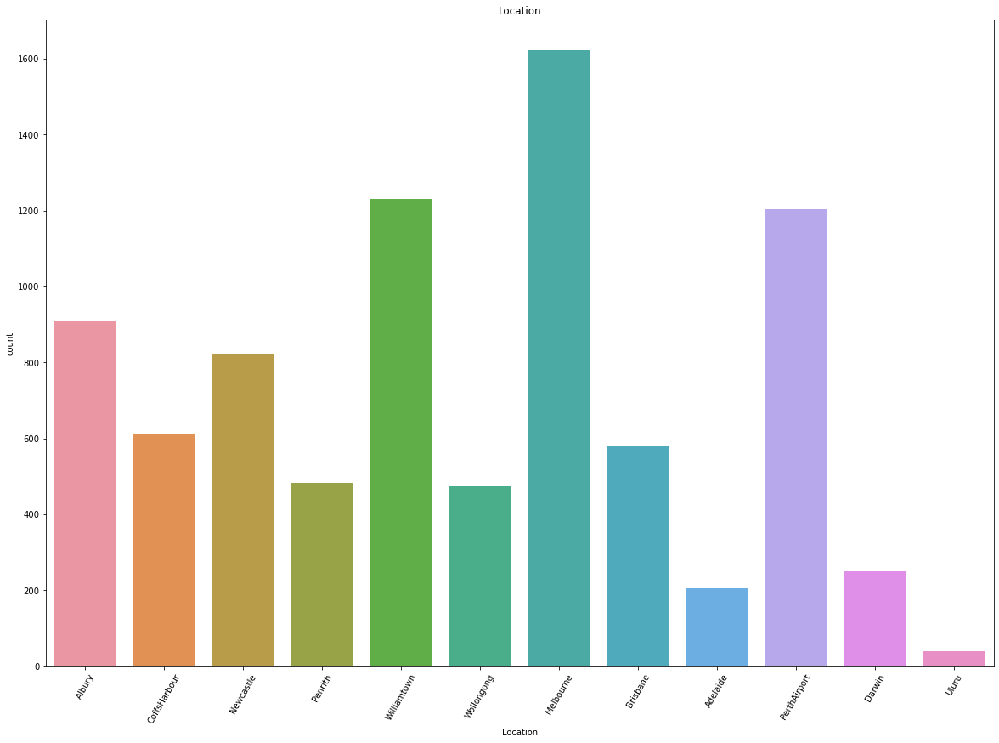

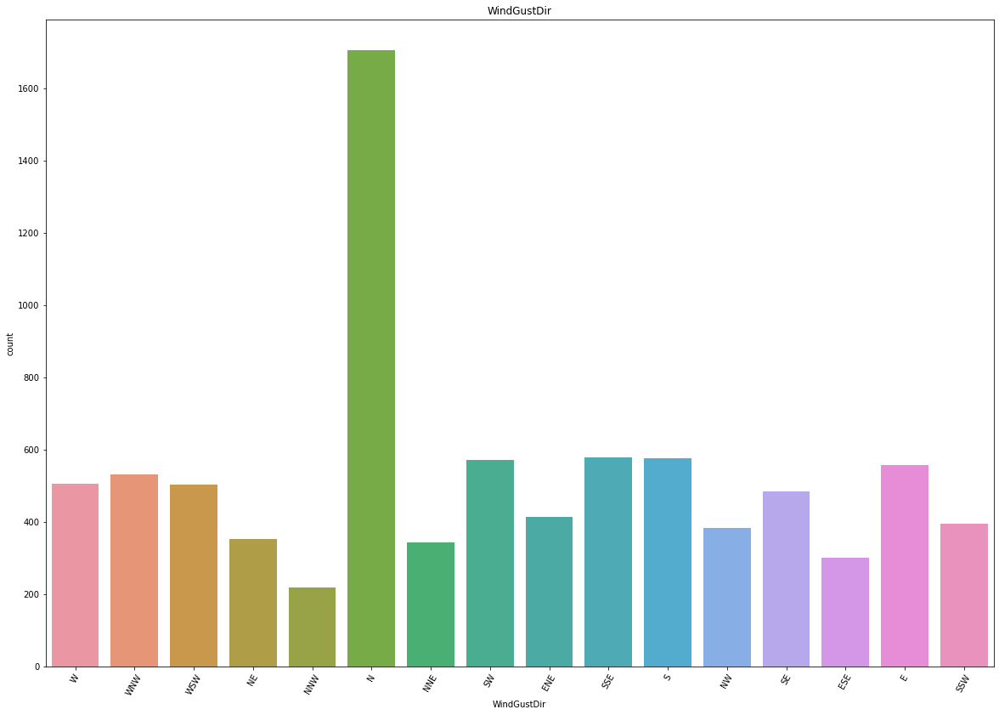

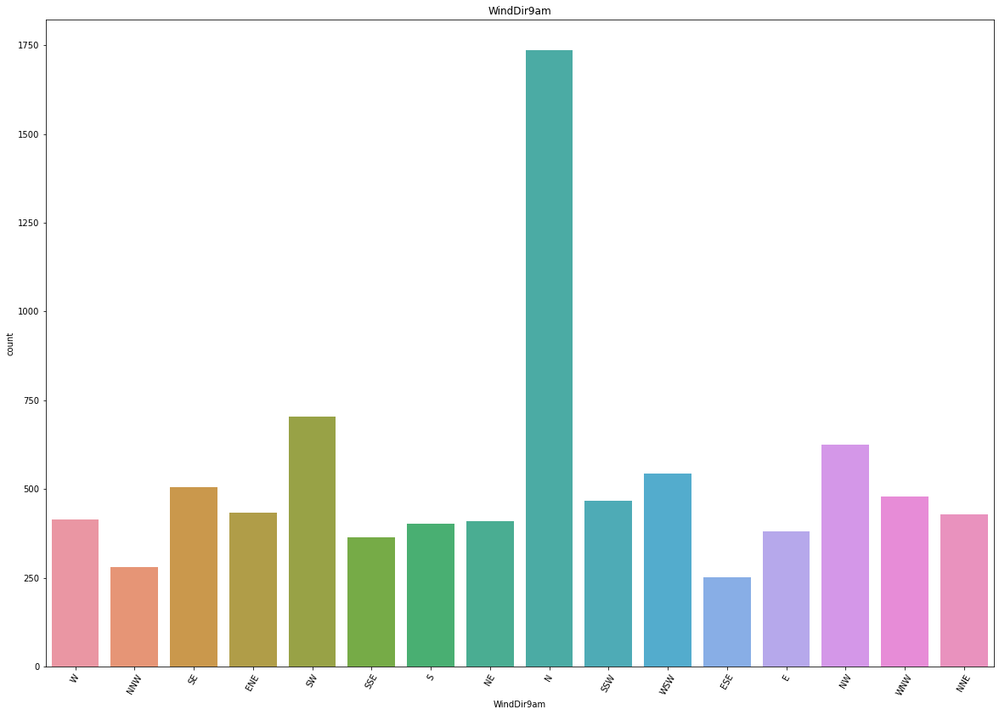

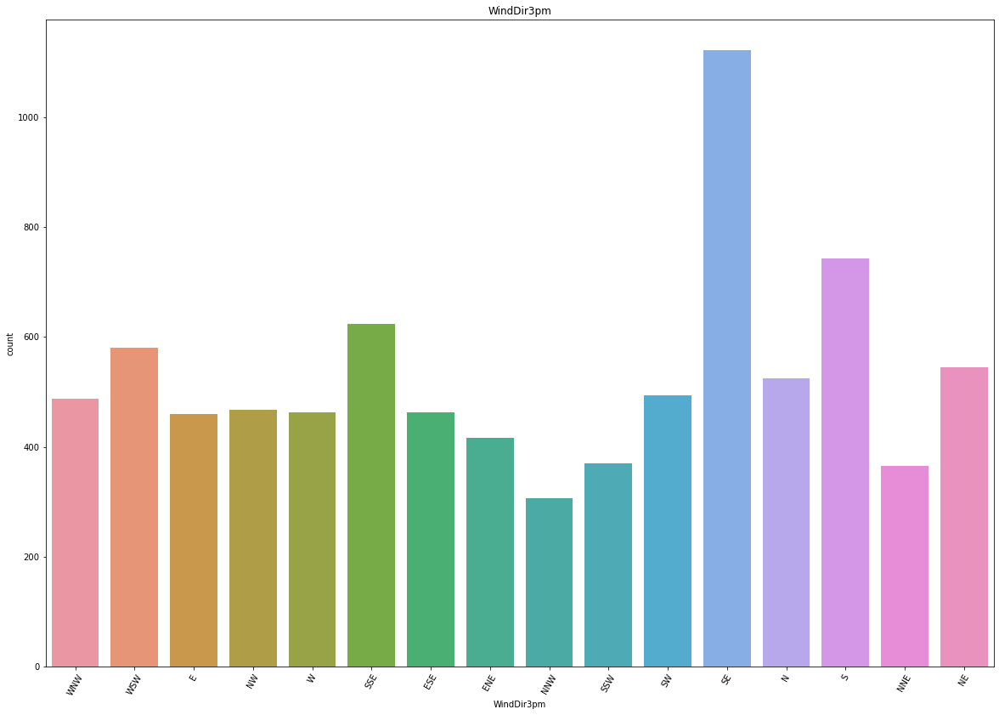

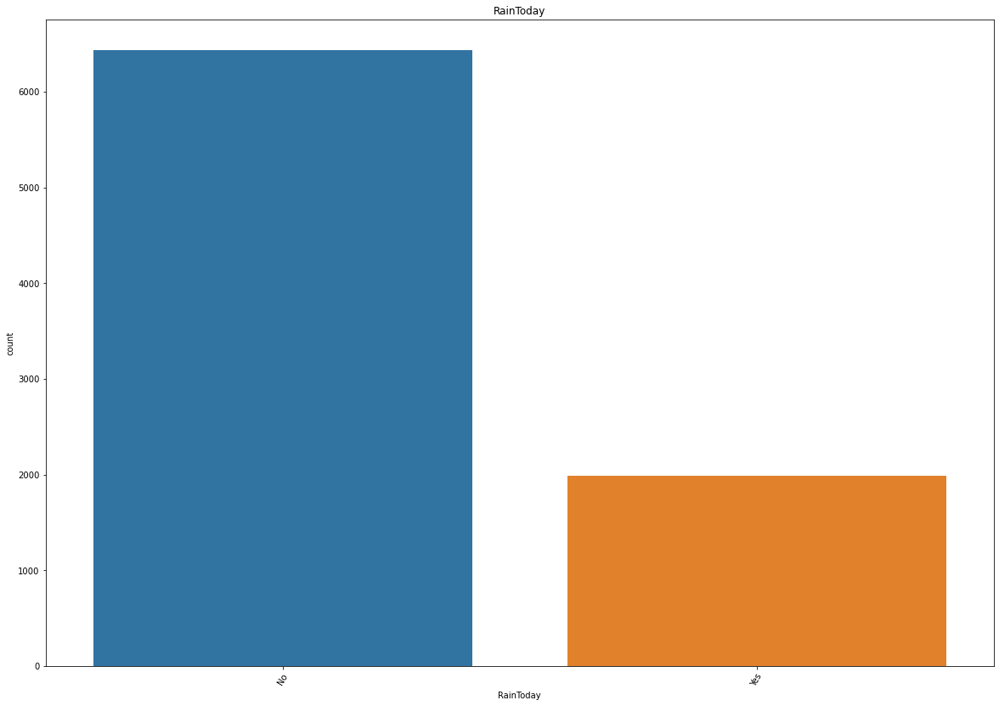

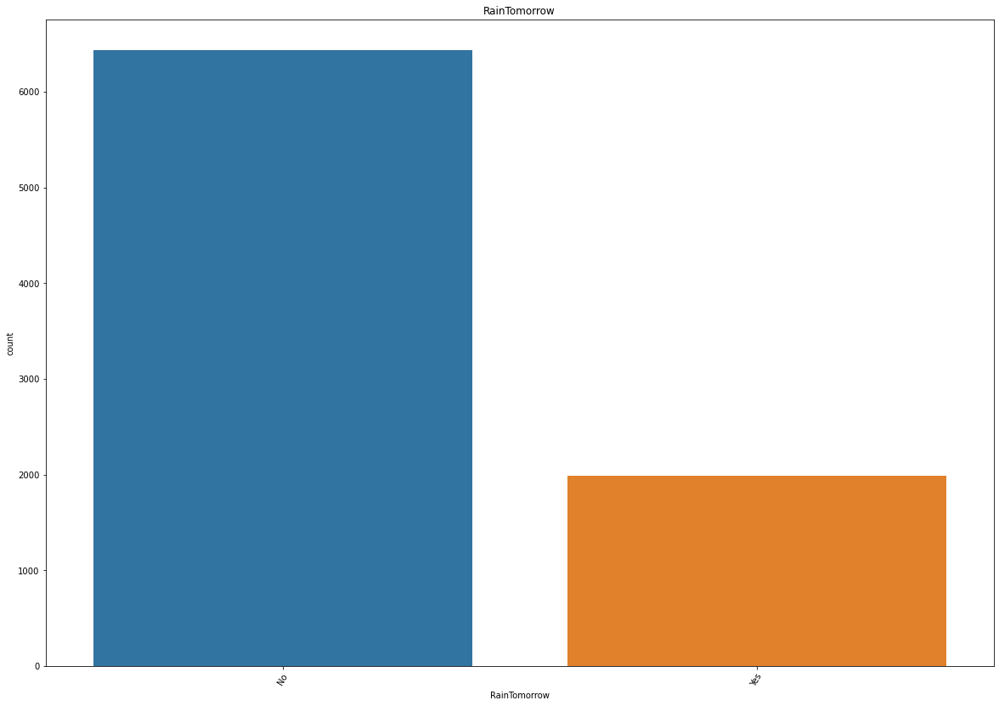

In [ ]:
# countplot for object types features

# countplot for object types features

for i in df[object_datatypes]:              
    plt.figure(figsize = (20, 14))
    sns.countplot(df[i])
    plt.title(i)
    plt.xticks(rotation=60)
    plt.show()

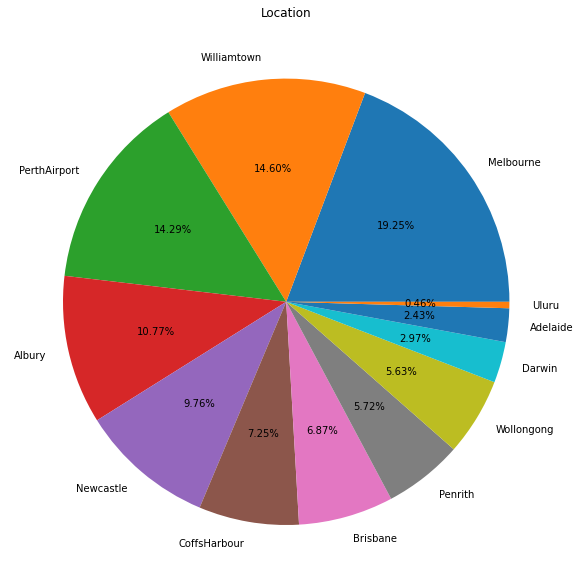

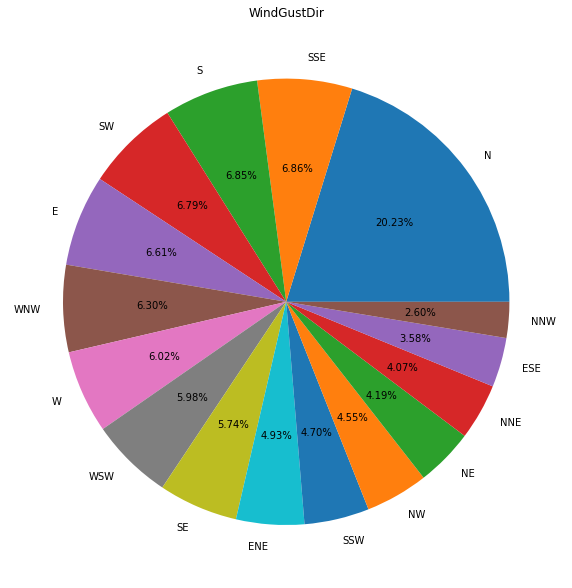

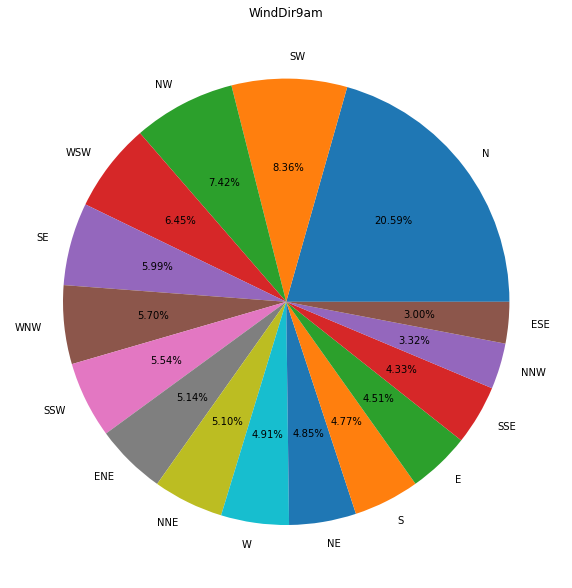

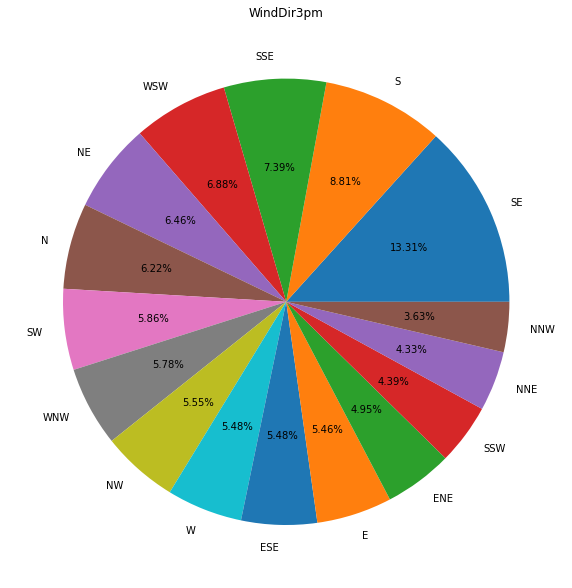

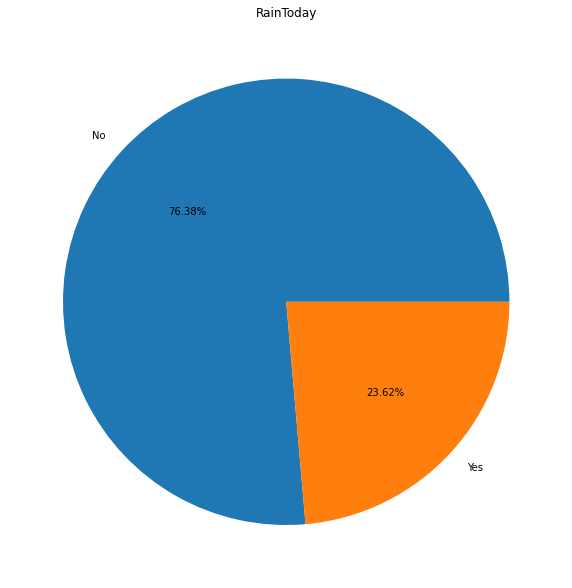

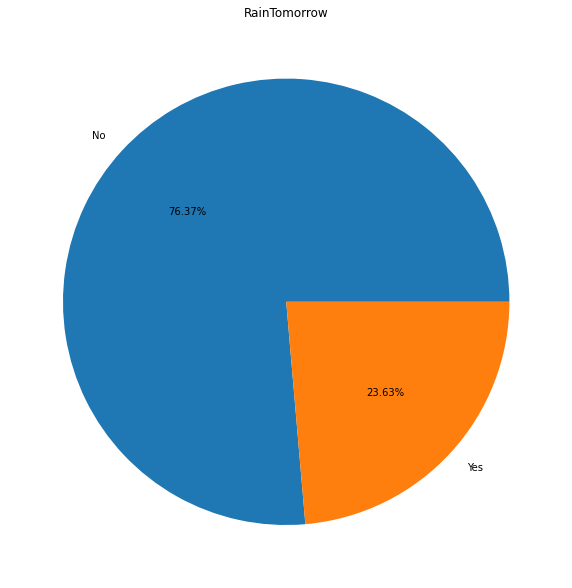

In [ ]:
# piechart for object types features

for i in df[object_datatypes]:              
    plt.figure(figsize = (10, 14))
    plt.pie(df[i].value_counts().values,labels=df[i].value_counts().index,autopct='%1.2f%%')
    plt.title(i)
    plt.xticks(rotation=60)
    plt.show()

In [ ]:
# Observation:-

# Location Melbourne has the most data and Uluru has the least data in the dataset.
# The strongest wind direction or(Wind gust speed) in a day ranges variedly and most of the data says North.
# Morning Wind direction(9.00 am) also shows North as the most in the dataset.
# Evening wind direction (3.00 pm) shows South east as the most in the dataset.
# Most of the time there is NO rain today and No Rain predicted for tomorrow.

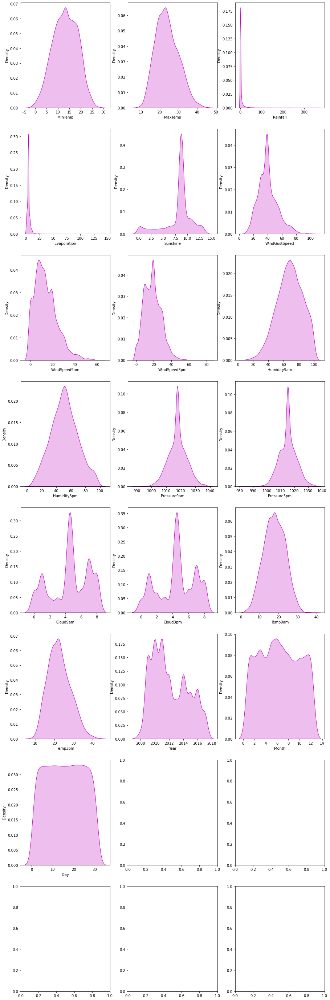

In [ ]:
# distplot for numerical type features

fig, ax = plt.subplots(ncols=3, nrows=8, figsize=(15,50))
index = 0
ax = ax.flatten()
for col, value in df[numerical_datatypes].items():
    sns.distplot(value, ax=ax[index], hist=False, color="m", kde_kws={"shade": True})
    index += 1
plt.show()

In [ ]:
# Most of the columns are normally distributed except for the following:-
# Rainfall, Evaporation and Windspeed9am, Windspeed3pm,Humidity9am, Pressure9am,Pressure3pm and all these contain skewness.

In [ ]:
# to check the outliers let's check the boxplots first...

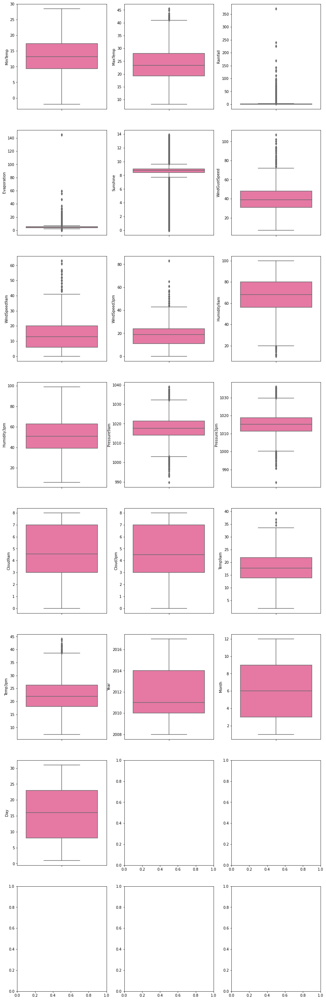

In [ ]:
# Boxplot for the integer type features 

fig, ax = plt.subplots(ncols=3, nrows=8, figsize=(15,50))
index = 0
ax = ax.flatten()
for col, value in df[numerical_datatypes].items():
    sns.boxplot(y=col, data=df, ax=ax[index], palette="RdPu")
    index += 1
plt.show()

In [ ]:
# The following columns have outliers...
# 'MaxTemp','Rainfall','Evaporation','Sunshine','WindGustSpeed','WindSpeed9am','WindSpeed3pm','Humidity9am','Pressure9am','Pressure3pm','Temp9am','Temp3pm'

In [ ]:
outlier_col= df [['MaxTemp','Rainfall','Evaporation','Sunshine','WindGustSpeed',
              'WindSpeed9am','WindSpeed3pm','Humidity9am','Pressure9am','Pressure3pm','Temp9am','Temp3pm']]

In [ ]:
df.shape

(8425, 25)

In [ ]:
# Using Z Score to remove outliers

from scipy.stats import zscore
import numpy as np
z=np.abs(zscore(outlier_col))
threshold= 3
np.where(z>3)

(array([  12,   12,   44,   44,   52,   52,   60,   60,   61,   61,   62,
          62,   62,   67,   68,   68,  123,  267,  296,  381,  381,  405,
         406,  407,  407,  431,  462,  563,  568,  568,  569,  602,  683,
         683,  699,  713,  748,  748,  770,  796,  797,  802,  928,  935,
         949,  979,  980,  980,  980, 1008, 1009, 1011, 1138, 1148, 1149,
        1151, 1189, 1202, 1203, 1237, 1241, 1264, 1265, 1357, 1411, 1412,
        1413, 1479, 1480, 1481, 1513, 1535, 1587, 1644, 1661, 1665, 1673,
        1680, 1774, 1819, 1873, 1898, 1903, 1945, 2016, 2028, 2043, 2063,
        2074, 2108, 2116, 2186, 2201, 2219, 2219, 2230, 2231, 2265, 2429,
        2488, 2500, 2505, 2527, 2527, 2541, 2593, 2676, 2677, 2735, 2827,
        2835, 2849, 2849, 2855, 2859, 2863, 2869, 2877, 2883, 2890, 2891,
        2897, 2898, 2900, 2901, 2905, 2909, 2911, 2919, 2925, 2933, 2939,
        2947, 2953, 2961, 2967, 2975, 2989, 3003, 3051, 3051, 3058, 3059,
        3059, 3060, 3066, 3067, 3067, 

In [ ]:
df= df[(z<3).all(axis=1)]
df

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Year,Month,Day
0,Albury,13.4,22.900000,0.6,4.6,8.7,W,44.0,W,WNW,...,1007.1,8.000000,4.503183,16.9,21.8,No,No,2008,12,1
1,Albury,7.4,25.100000,0.0,4.6,8.7,WNW,44.0,NNW,WSW,...,1007.8,4.566622,4.503183,17.2,24.3,No,No,2008,12,2
2,Albury,12.9,25.700000,0.0,4.6,8.7,WSW,46.0,W,WSW,...,1008.7,4.566622,2.000000,21.0,23.2,No,No,2008,12,3
3,Albury,9.2,28.000000,0.0,4.6,8.7,NE,24.0,SE,E,...,1012.8,4.566622,4.503183,18.1,26.5,No,No,2008,12,4
4,Albury,17.5,32.300000,1.0,4.6,8.7,W,41.0,ENE,NW,...,1006.0,7.000000,8.000000,17.8,29.7,No,No,2008,12,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,Uluru,2.8,23.400000,0.0,4.6,8.7,E,31.0,SE,ENE,...,1020.3,4.566622,4.503183,10.1,22.4,No,No,2017,6,21
8421,Uluru,3.6,25.300000,0.0,4.6,8.7,NNW,22.0,SE,N,...,1019.1,4.566622,4.503183,10.9,24.5,No,No,2017,6,22
8422,Uluru,5.4,26.900000,0.0,4.6,8.7,N,37.0,SE,WNW,...,1016.8,4.566622,4.503183,12.5,26.1,No,No,2017,6,23
8423,Uluru,7.8,27.000000,0.0,4.6,8.7,SE,28.0,SSE,N,...,1016.5,3.000000,2.000000,15.1,26.0,No,No,2017,6,24


In [ ]:
df.shape

(7987, 25)

In [ ]:
#checking the loss percentage

loss_percentage=(((8425-7987)/8425)*100)
loss_percentage

5.198813056379822

In [ ]:
# since loss percentage is below 10% we will proceed with this...

In [ ]:
# now again check the boxplot

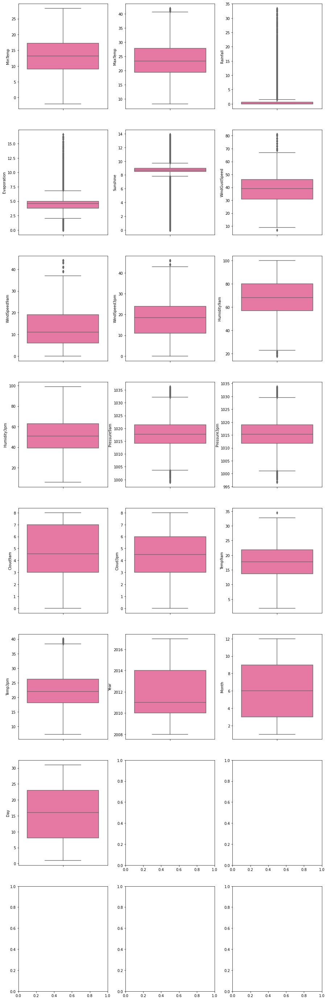

In [ ]:
# Boxplot

fig, ax = plt.subplots(ncols=3, nrows=8, figsize=(15,50))
index = 0
ax = ax.flatten()
for col, value in df[numerical_datatypes].items():
    sns.boxplot(y=col, data=df, ax=ax[index], palette="RdPu")
    index += 1
plt.show()

In [ ]:
# Most of the outliers are now of the continuous form so we can ignore this and proceed further...

In [ ]:
# Encoding the object datatype columns

In [ ]:
df

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Year,Month,Day
0,Albury,13.4,22.900000,0.6,4.6,8.7,W,44.0,W,WNW,...,1007.1,8.000000,4.503183,16.9,21.8,No,No,2008,12,1
1,Albury,7.4,25.100000,0.0,4.6,8.7,WNW,44.0,NNW,WSW,...,1007.8,4.566622,4.503183,17.2,24.3,No,No,2008,12,2
2,Albury,12.9,25.700000,0.0,4.6,8.7,WSW,46.0,W,WSW,...,1008.7,4.566622,2.000000,21.0,23.2,No,No,2008,12,3
3,Albury,9.2,28.000000,0.0,4.6,8.7,NE,24.0,SE,E,...,1012.8,4.566622,4.503183,18.1,26.5,No,No,2008,12,4
4,Albury,17.5,32.300000,1.0,4.6,8.7,W,41.0,ENE,NW,...,1006.0,7.000000,8.000000,17.8,29.7,No,No,2008,12,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,Uluru,2.8,23.400000,0.0,4.6,8.7,E,31.0,SE,ENE,...,1020.3,4.566622,4.503183,10.1,22.4,No,No,2017,6,21
8421,Uluru,3.6,25.300000,0.0,4.6,8.7,NNW,22.0,SE,N,...,1019.1,4.566622,4.503183,10.9,24.5,No,No,2017,6,22
8422,Uluru,5.4,26.900000,0.0,4.6,8.7,N,37.0,SE,WNW,...,1016.8,4.566622,4.503183,12.5,26.1,No,No,2017,6,23
8423,Uluru,7.8,27.000000,0.0,4.6,8.7,SE,28.0,SSE,N,...,1016.5,3.000000,2.000000,15.1,26.0,No,No,2017,6,24


In [ ]:
object_datatypes

['Location',
 'WindGustDir',
 'WindDir9am',
 'WindDir3pm',
 'RainToday',
 'RainTomorrow']

In [ ]:
from sklearn.preprocessing import LabelEncoder
le=LabelEncoder()
df[object_datatypes]= df[object_datatypes].apply(le.fit_transform)

In [ ]:
df.dtypes

Location           int32
MinTemp          float64
MaxTemp          float64
Rainfall         float64
Evaporation      float64
Sunshine         float64
WindGustDir        int32
WindGustSpeed    float64
WindDir9am         int32
WindDir3pm         int32
WindSpeed9am     float64
WindSpeed3pm     float64
Humidity9am      float64
Humidity3pm      float64
Pressure9am      float64
Pressure3pm      float64
Cloud9am         float64
Cloud3pm         float64
Temp9am          float64
Temp3pm          float64
RainToday          int32
RainTomorrow       int32
Year               int64
Month              int64
Day                int64
dtype: object

In [ ]:
df

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Year,Month,Day
0,1,13.4,22.900000,0.6,4.6,8.7,13,44.0,13,14,...,1007.1,8.000000,4.503183,16.9,21.8,0,0,2008,12,1
1,1,7.4,25.100000,0.0,4.6,8.7,14,44.0,6,15,...,1007.8,4.566622,4.503183,17.2,24.3,0,0,2008,12,2
2,1,12.9,25.700000,0.0,4.6,8.7,15,46.0,13,15,...,1008.7,4.566622,2.000000,21.0,23.2,0,0,2008,12,3
3,1,9.2,28.000000,0.0,4.6,8.7,4,24.0,9,0,...,1012.8,4.566622,4.503183,18.1,26.5,0,0,2008,12,4
4,1,17.5,32.300000,1.0,4.6,8.7,13,41.0,1,7,...,1006.0,7.000000,8.000000,17.8,29.7,0,0,2008,12,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,9,2.8,23.400000,0.0,4.6,8.7,0,31.0,9,1,...,1020.3,4.566622,4.503183,10.1,22.4,0,0,2017,6,21
8421,9,3.6,25.300000,0.0,4.6,8.7,6,22.0,9,3,...,1019.1,4.566622,4.503183,10.9,24.5,0,0,2017,6,22
8422,9,5.4,26.900000,0.0,4.6,8.7,3,37.0,9,14,...,1016.8,4.566622,4.503183,12.5,26.1,0,0,2017,6,23
8423,9,7.8,27.000000,0.0,4.6,8.7,9,28.0,10,3,...,1016.5,3.000000,2.000000,15.1,26.0,0,0,2017,6,24


In [ ]:
# we have successfully changed all the object type data into int or numerical type ones!

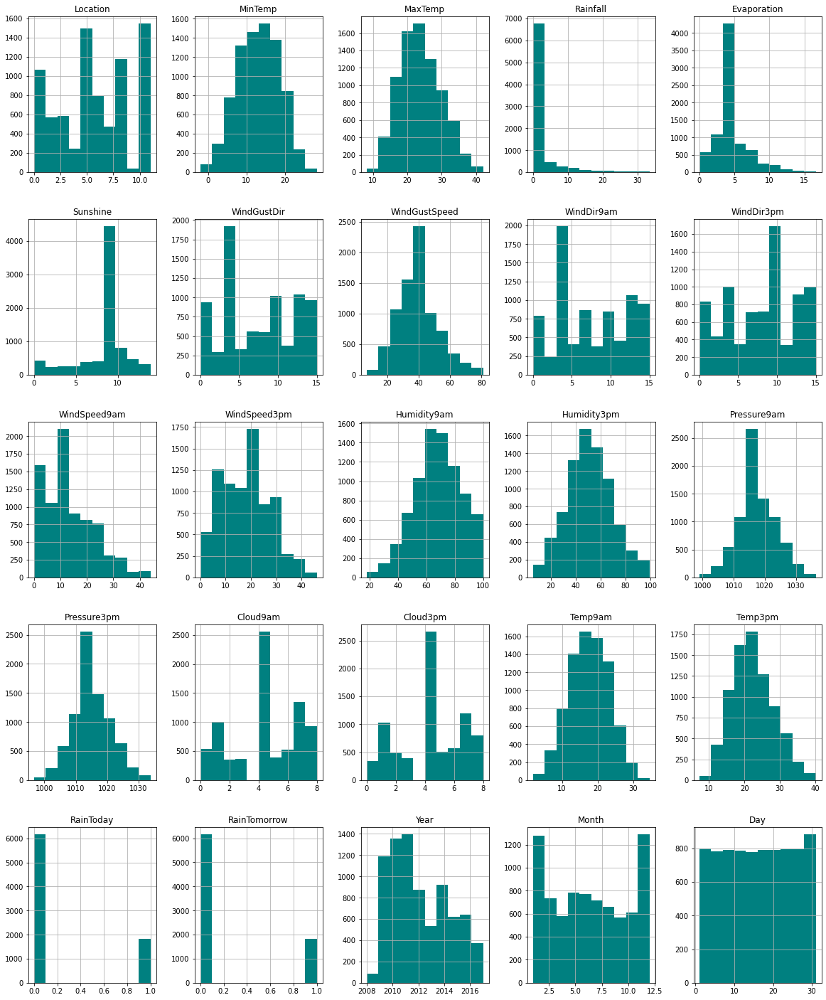

In [ ]:
df.hist(figsize=(20,25), color= 'teal')
plt.show()

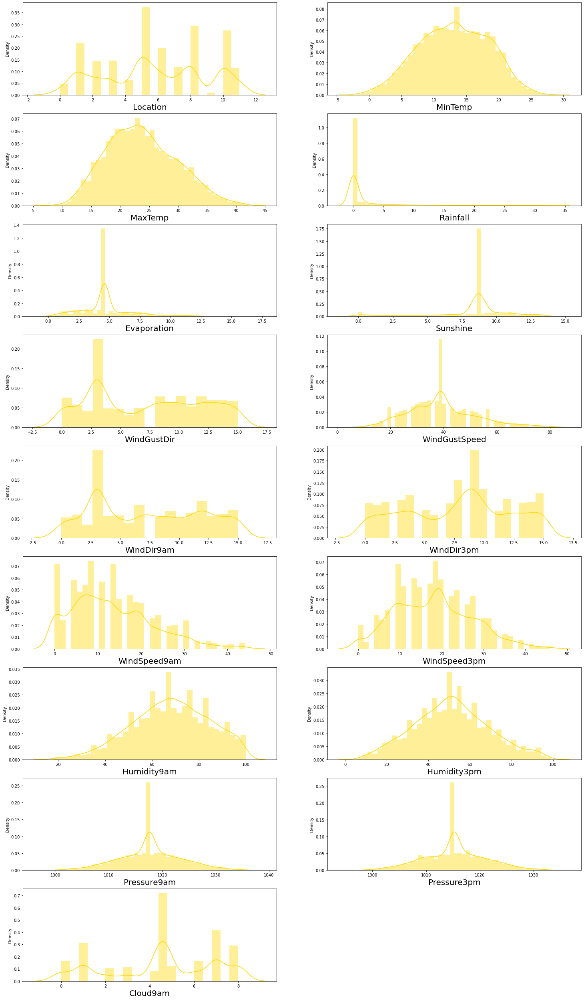

In [ ]:
#Univariate Analysis

plt.figure(figsize = (25,50), facecolor = 'white')
plotnumber = 1

for column in df:
    if plotnumber <=17:
        ax = plt.subplot(10,2,plotnumber)
        sns.distplot(df[column], color = 'gold')
        plt.xlabel(column,fontsize=20)
        
    plotnumber +=1
plt.show()

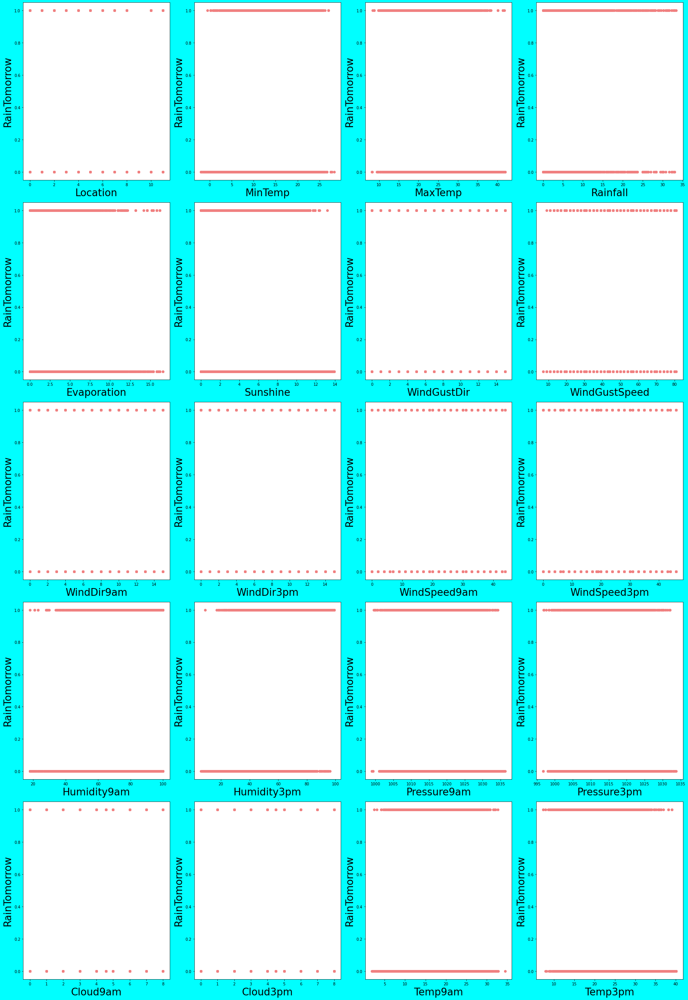

In [ ]:
#Bivariate Analysis w.r.t RainTomorrow

plt.figure(figsize = (25,50), facecolor = 'cyan')
plotnumber = 1

for column in df:
    if plotnumber <=20:
        ax = plt.subplot(7,4,plotnumber)
        plt.scatter(df[column],df['RainTomorrow'], color='lightcoral')
        plt.xlabel(column,fontsize=26)
        plt.ylabel('RainTomorrow', fontsize=26)
    plotnumber += 1
plt.tight_layout()

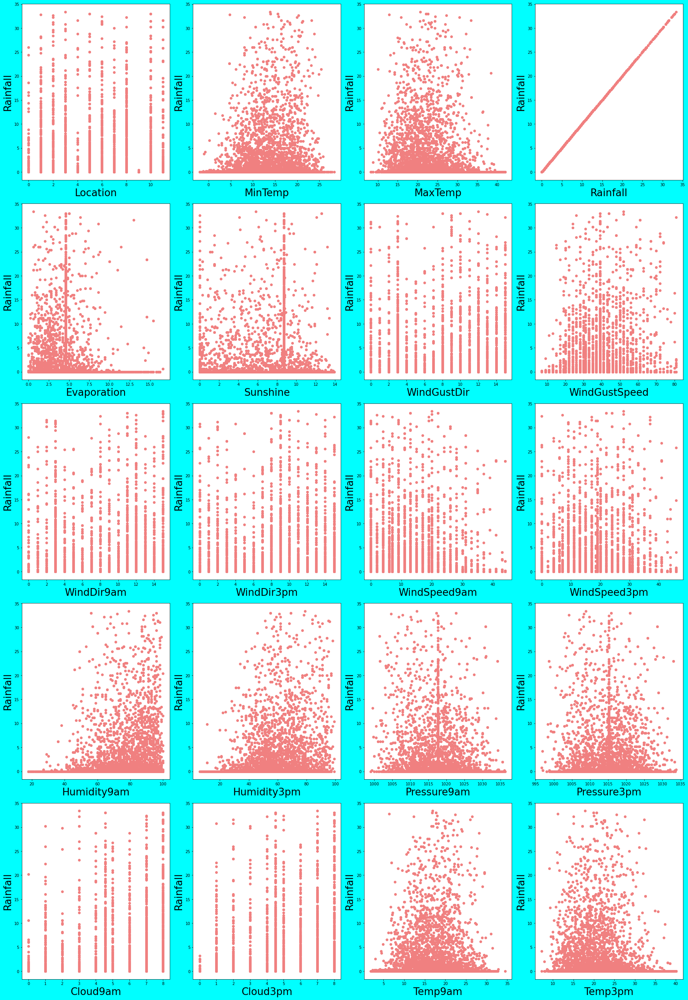

In [ ]:
#Bivariate Analysis w.r.t Rainfall

plt.figure(figsize = (25,50), facecolor = 'cyan')
plotnumber = 1

for column in df:
    if plotnumber <=20:
        ax = plt.subplot(7,4,plotnumber)
        plt.scatter(df[column],df['Rainfall'], color='lightcoral')
        plt.xlabel(column,fontsize=26)
        plt.ylabel('Rainfall', fontsize=26)
    plotnumber += 1
plt.tight_layout()

In [ ]:
# Relationships are not clear!

In [ ]:
#Lets plot a stacked plot of object type cols with target

def stacked_plot(df, group, target):
    fig, ax = plt.subplots(figsize = (6,4))
    temp_df = (df.groupby([group, target]).size()/df.groupby(group)[target].count()).reset_index().pivot(columns=target, index=group, values=0)
    temp_df.plot(kind='bar', stacked=True, ax = ax, color = ["cyan", "lightcoral"])
    ax.xaxis.set_tick_params(rotation=60)
    ax.set_xlabel(group)
    ax.set_ylabel('RainTomorrow percentage')

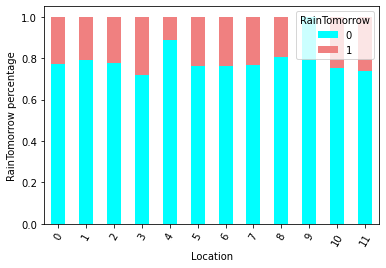

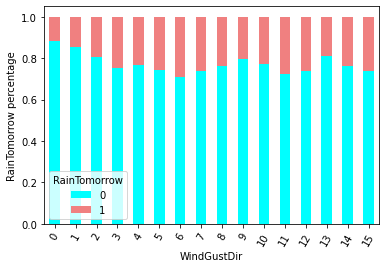

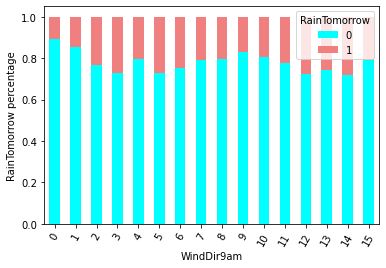

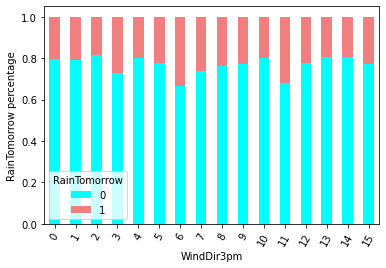

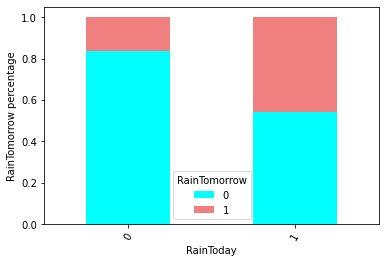

In [ ]:
#lets check for Location, WindGustDir,WindDir9am, WindDir3pm and RainToday

stacked_plot(df, "Location", "RainTomorrow")
stacked_plot(df, "WindGustDir", "RainTomorrow")
stacked_plot(df, "WindDir9am", "RainTomorrow")
stacked_plot(df, "WindDir3pm", "RainTomorrow")
stacked_plot(df, "RainToday", "RainTomorrow")

In [ ]:
# Observations:

# The rate of Rainfall predicted for tomorrow is more for CoffsHarbour and zero for Uluru.
# The rainfal rate is the most when the WindGustdirection is NNW and SSW.
# The windDir9am doesnt have a specific pattern but WindDir3pm suggest that rainfall is predicted to happen when it NNW and SSW.
# We can see that Raintoday and Raintomorrow are correlated highly.

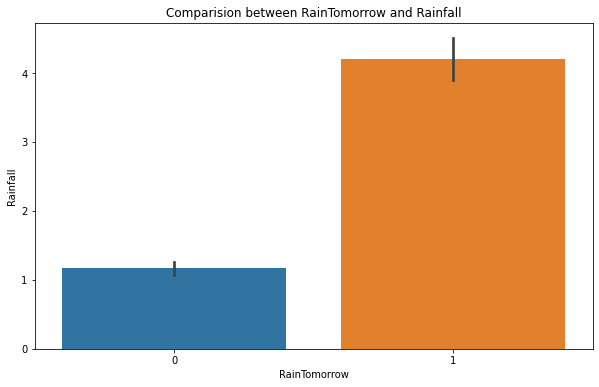

In [ ]:
# Checking the relationship between both the targets

plt.figure(figsize = (10,6))
plt.title("Comparision between RainTomorrow and Rainfall")
sns.barplot(x = "RainTomorrow", y = "Rainfall", data = df)
plt.show()

In [ ]:
# Multivariate Analysis

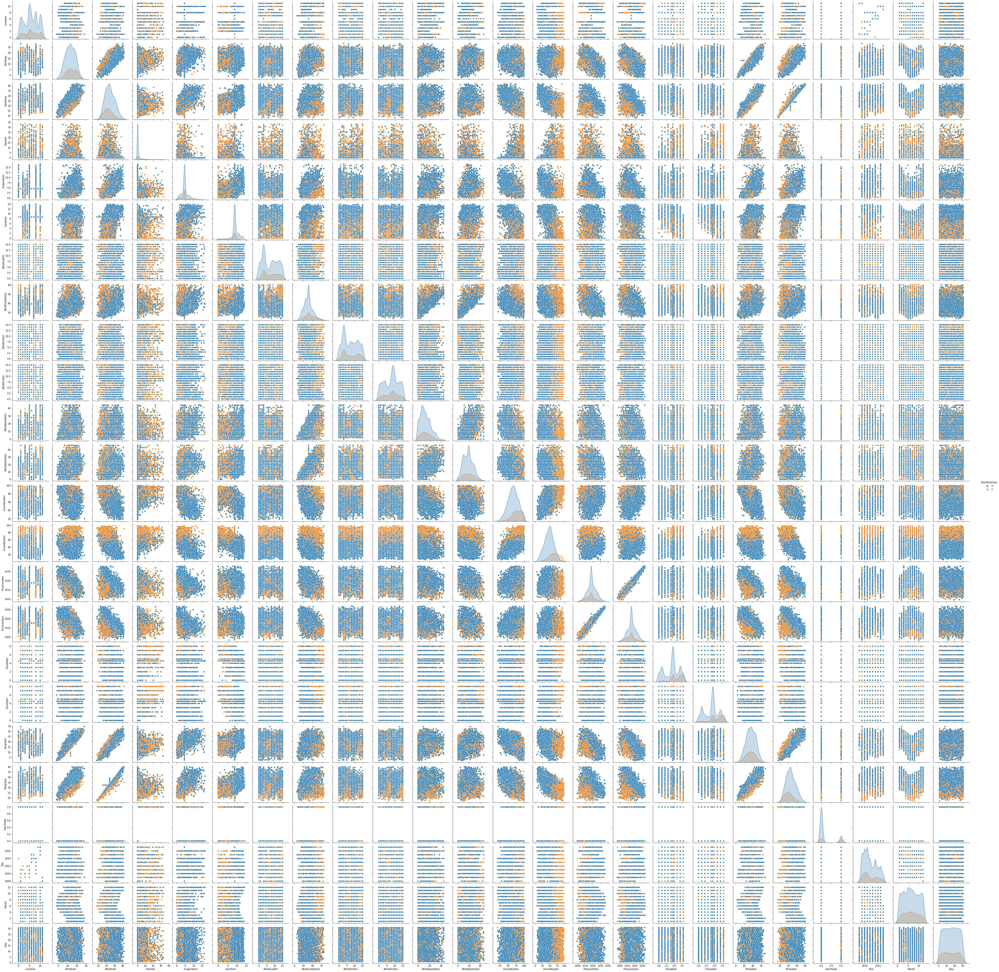

In [ ]:
sns.pairplot(df,hue="RainTomorrow")

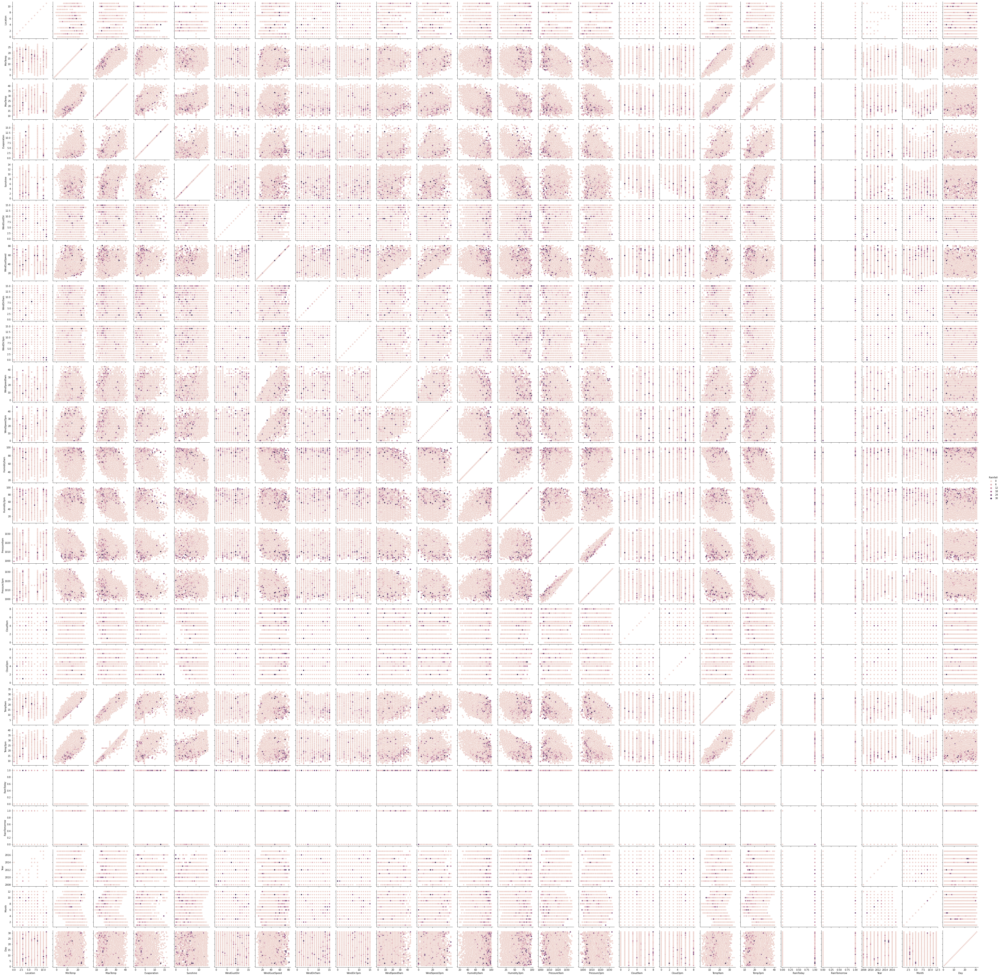

In [ ]:
g = sns.PairGrid(df , hue = 'Rainfall')
g = g.map(sns.scatterplot)
g.add_legend()

In [ ]:
# There is no specific pattern between Raintomorrow and day, month and year.
# Although April, June and November has the highest Rainfall.
# We can see some linear relation between target and variables.
# Multicollinearity is present in the dataset.

In [ ]:
df.corr()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Year,Month,Day
Location,1.000000,0.116694,0.063798,0.017936,0.111007,0.077736,-0.037707,0.244310,-0.041030,-0.031195,...,-0.012288,0.041859,0.027050,0.118100,0.060707,0.002934,0.009222,0.481143,-0.086011,-0.004978
MinTemp,0.116694,1.000000,0.718598,0.088980,0.390542,0.039533,-0.154935,0.231330,-0.045231,-0.154184,...,-0.427936,0.089354,0.036649,0.888690,0.687570,0.061728,0.091021,0.040001,-0.247066,0.010924
MaxTemp,0.063798,0.718598,1.000000,-0.138506,0.479928,0.365556,-0.237955,0.136056,-0.217160,-0.190417,...,-0.414358,-0.252579,-0.248268,0.864864,0.974957,-0.219747,-0.149708,0.120204,-0.164351,0.017068
Rainfall,0.017936,0.088980,-0.138506,1.000000,-0.094340,-0.158983,0.081196,0.087985,0.121580,0.074577,...,-0.039030,0.220778,0.187137,-0.033526,-0.146589,0.697522,0.267970,0.005928,-0.007054,-0.013772
Evaporation,0.111007,0.390542,0.479928,-0.094340,1.000000,0.357187,-0.112114,0.221343,-0.102856,-0.036355,...,-0.276857,-0.140534,-0.164584,0.463043,0.463262,-0.165871,-0.091518,0.082739,-0.042328,0.014565
Sunshine,0.077736,0.039533,0.365556,-0.158983,0.357187,1.000000,-0.106822,-0.012461,-0.085818,-0.066174,...,-0.058976,-0.487916,-0.511960,0.229400,0.384769,-0.214179,-0.310900,0.125526,-0.007029,0.002258
WindGustDir,-0.037707,-0.154935,-0.237955,0.081196,-0.112114,-0.106822,1.000000,0.015216,0.405681,0.507292,...,-0.008263,0.123415,0.093527,-0.185080,-0.249791,0.121709,0.044378,-0.096042,0.038044,0.017003
WindGustSpeed,0.244310,0.231330,0.136056,0.087985,0.221343,-0.012461,0.015216,1.000000,-0.065432,0.076140,...,-0.335697,0.015800,0.065196,0.198924,0.101425,0.076934,0.181673,-0.043508,0.044803,-0.004712
WindDir9am,-0.041030,-0.045231,-0.217160,0.121580,-0.102856,-0.085818,0.405681,-0.065432,1.000000,0.243622,...,0.081400,0.092396,0.062637,-0.101576,-0.224390,0.149239,0.027091,-0.034468,0.018344,-0.010014
WindDir3pm,-0.031195,-0.154184,-0.190417,0.074577,-0.036355,-0.066174,0.507292,0.076140,0.243622,1.000000,...,-0.037280,0.073742,0.054321,-0.172000,-0.202000,0.100983,0.003674,-0.010781,0.028629,-0.000714


<AxesSubplot:>

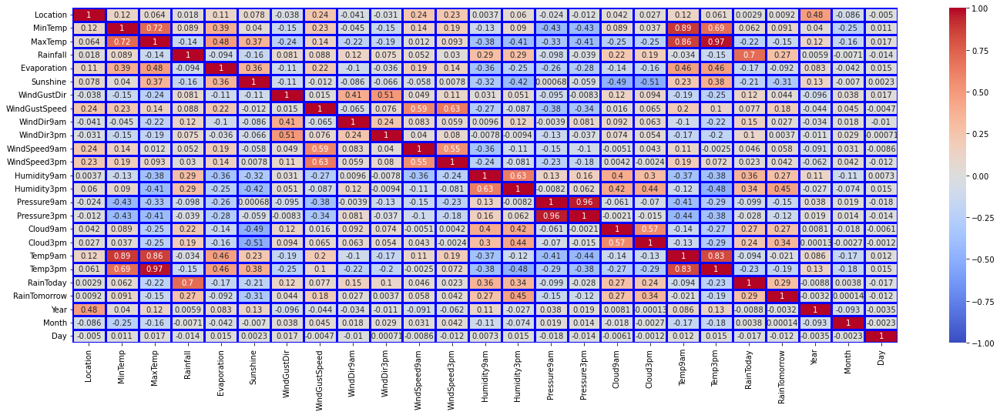

In [ ]:
#let us make a heatmap

import matplotlib.pyplot as plt
plt.figure(figsize=(24,8))
sns.heatmap(df.corr(), annot = True, vmin=-1, vmax=1, center= 0, cmap= 'coolwarm', linewidths=3, linecolor='blue')

In [ ]:
# skewness

In [ ]:
df.skew().sort_values()

Sunshine        -1.210547
Cloud9am        -0.356892
Cloud3pm        -0.266829
Humidity9am     -0.231656
WindDir3pm      -0.126255
MinTemp         -0.084549
Location        -0.040284
Temp9am         -0.038035
Day              0.002731
Pressure9am      0.020735
Pressure3pm      0.044876
Month            0.054460
WindGustDir      0.112339
Humidity3pm      0.125150
WindDir9am       0.160081
WindSpeed3pm     0.300109
MaxTemp          0.314510
Temp3pm          0.334170
Year             0.430100
WindGustSpeed    0.539852
WindSpeed9am     0.713786
Evaporation      1.280696
RainTomorrow     1.296077
RainToday        1.301170
Rainfall         3.519090
dtype: float64

In [ ]:
numerical_datatypes

['MinTemp',
 'MaxTemp',
 'Rainfall',
 'Evaporation',
 'Sunshine',
 'WindGustSpeed',
 'WindSpeed9am',
 'WindSpeed3pm',
 'Humidity9am',
 'Humidity3pm',
 'Pressure9am',
 'Pressure3pm',
 'Cloud9am',
 'Cloud3pm',
 'Temp9am',
 'Temp3pm',
 'Year',
 'Month',
 'Day']

In [ ]:
df[numerical_datatypes].skew().sort_values()

Sunshine        -1.210547
Cloud9am        -0.356892
Cloud3pm        -0.266829
Humidity9am     -0.231656
MinTemp         -0.084549
Temp9am         -0.038035
Day              0.002731
Pressure9am      0.020735
Pressure3pm      0.044876
Month            0.054460
Humidity3pm      0.125150
WindSpeed3pm     0.300109
MaxTemp          0.314510
Temp3pm          0.334170
Year             0.430100
WindGustSpeed    0.539852
WindSpeed9am     0.713786
Evaporation      1.280696
Rainfall         3.519090
dtype: float64

In [ ]:
# clearly we have skewness in Rainfall, Evaporation, WindGustSpeed, WindSpeed9am and Sunshine.

In [ ]:
# Using Power transformer to remove skewness

In [ ]:
skew_cols= ['Rainfall', 'Evaporation', 'WindGustSpeed', 'WindSpeed9am','Sunshine']

In [ ]:
from sklearn.preprocessing import PowerTransformer
scaler = PowerTransformer(method='yeo-johnson')
df[skew_cols] = scaler.fit_transform(df[skew_cols].values)

In [ ]:
df.skew().sort_values()

Cloud9am        -0.356892
Cloud3pm        -0.266829
Humidity9am     -0.231656
Sunshine        -0.216154
WindDir3pm      -0.126255
WindSpeed9am    -0.110908
MinTemp         -0.084549
Location        -0.040284
Temp9am         -0.038035
Day              0.002731
WindGustSpeed    0.004523
Pressure9am      0.020735
Pressure3pm      0.044876
Month            0.054460
Evaporation      0.061105
WindGustDir      0.112339
Humidity3pm      0.125150
WindDir9am       0.160081
WindSpeed3pm     0.300109
MaxTemp          0.314510
Temp3pm          0.334170
Year             0.430100
Rainfall         1.040980
RainTomorrow     1.296077
RainToday        1.301170
dtype: float64

In [ ]:
# We still have skewness in rainfall

In [ ]:
skew_cols= ['Rainfall']
from sklearn.preprocessing import PowerTransformer
scaler = PowerTransformer(method='yeo-johnson')
df[skew_cols] = scaler.fit_transform(df[skew_cols].values)

In [ ]:
df.skew().sort_values()

Cloud9am        -0.356892
Cloud3pm        -0.266829
Humidity9am     -0.231656
Sunshine        -0.216154
WindDir3pm      -0.126255
WindSpeed9am    -0.110908
MinTemp         -0.084549
Location        -0.040284
Temp9am         -0.038035
Day              0.002731
WindGustSpeed    0.004523
Pressure9am      0.020735
Pressure3pm      0.044876
Month            0.054460
Evaporation      0.061105
WindGustDir      0.112339
Humidity3pm      0.125150
WindDir9am       0.160081
WindSpeed3pm     0.300109
MaxTemp          0.314510
Temp3pm          0.334170
Year             0.430100
Rainfall         0.773463
RainTomorrow     1.296077
RainToday        1.301170
dtype: float64

In [ ]:
# We still have skewness in rainfall

In [ ]:
skew_cols= ['Rainfall']
from sklearn.preprocessing import PowerTransformer
scaler = PowerTransformer(method='yeo-johnson')
df[skew_cols] = scaler.fit_transform(df[skew_cols].values)

In [ ]:
df.skew().sort_values()

Cloud9am        -0.356892
Cloud3pm        -0.266829
Humidity9am     -0.231656
Sunshine        -0.216154
WindDir3pm      -0.126255
WindSpeed9am    -0.110908
MinTemp         -0.084549
Location        -0.040284
Temp9am         -0.038035
Day              0.002731
WindGustSpeed    0.004523
Pressure9am      0.020735
Pressure3pm      0.044876
Month            0.054460
Evaporation      0.061105
WindGustDir      0.112339
Humidity3pm      0.125150
WindDir9am       0.160081
WindSpeed3pm     0.300109
MaxTemp          0.314510
Temp3pm          0.334170
Year             0.430100
Rainfall         0.704617
RainTomorrow     1.296077
RainToday        1.301170
dtype: float64

In [ ]:
# skewness has been removed much than before!

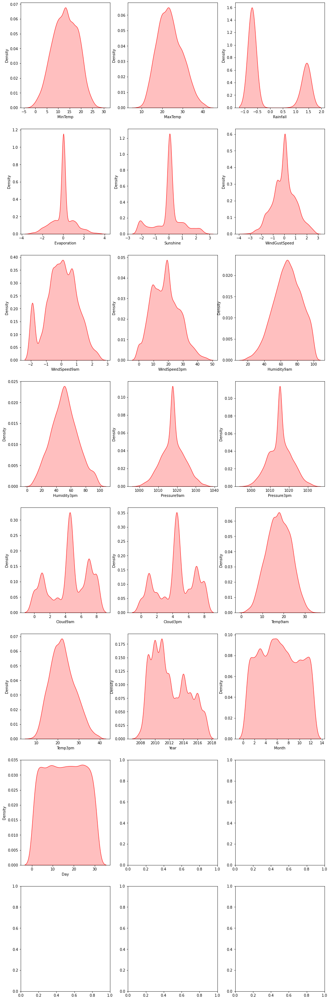

In [ ]:
# visualize the skewness

fig, ax = plt.subplots(ncols=3, nrows=8, figsize=(15,50))
index = 0
ax = ax.flatten()
for col, value in df[numerical_datatypes].items():
    sns.distplot(value, ax=ax[index], hist=False, color="r", kde_kws={"shade": True})
    index += 1
plt.show()

In [ ]:
# Following more normal distribution than before!

In [ ]:
# Handle missing values

In [ ]:
for i in df.columns:
    print( i ,'have unique values = ',df[i].unique(),'\n')

Location have unique values =  [ 1  3  6  7 10 11  5  2  0  8  4  9] 

MinTemp have unique values =  [13.4         7.4        12.9         9.2        17.5        14.6
 14.3         7.7         9.7        13.1        15.9        12.6
  8.4         9.8        14.1        13.5        11.2        11.5
 17.1        20.5        15.3        16.2        16.9        20.1
 19.7        12.5        12.         11.3         9.6        10.5
 12.3        13.7        16.1        14.         17.         17.3
 17.2        19.8        14.9        13.9        18.6        19.3
 18.8        20.8        15.7        18.5        20.4        21.8
 24.4        21.5        21.7        28.3        18.4        12.4
 13.3        18.         18.7        15.5         8.9        15.
 15.4        16.         12.8        13.2        13.8         7.6
  8.3        11.         20.9        16.4        10.          8.8
  9.3        14.4        10.8        10.1         9.1        10.4
 12.2        10.7         7.8         8.1 

In [ ]:
# there is no missing values there in the data set

In [ ]:
df

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Year,Month,Day
0,1,13.4,22.900000,1.389009,0.033069,0.068796,13,0.448790,13,14,...,1007.1,8.000000,4.503183,16.9,21.8,0,0,2008,12,1
1,1,7.4,25.100000,-0.710194,0.033069,0.068796,14,0.448790,6,15,...,1007.8,4.566622,4.503183,17.2,24.3,0,0,2008,12,2
2,1,12.9,25.700000,-0.710194,0.033069,0.068796,15,0.593637,13,15,...,1008.7,4.566622,2.000000,21.0,23.2,0,0,2008,12,3
3,1,9.2,28.000000,-0.710194,0.033069,0.068796,4,-1.250093,9,0,...,1012.8,4.566622,4.503183,18.1,26.5,0,0,2008,12,4
4,1,17.5,32.300000,1.424464,0.033069,0.068796,13,0.224831,1,7,...,1006.0,7.000000,8.000000,17.8,29.7,0,0,2008,12,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,9,2.8,23.400000,-0.710194,0.033069,0.068796,0,-0.591948,9,1,...,1020.3,4.566622,4.503183,10.1,22.4,0,0,2017,6,21
8421,9,3.6,25.300000,-0.710194,0.033069,0.068796,6,-1.456067,9,3,...,1019.1,4.566622,4.503183,10.9,24.5,0,0,2017,6,22
8422,9,5.4,26.900000,-0.710194,0.033069,0.068796,3,-0.087700,9,14,...,1016.8,4.566622,4.503183,12.5,26.1,0,0,2017,6,23
8423,9,7.8,27.000000,-0.710194,0.033069,0.068796,9,-0.863369,10,3,...,1016.5,3.000000,2.000000,15.1,26.0,0,0,2017,6,24


# Prediction:

1. RainTomorrow

In [ ]:
# Train-Test split

X = df.drop('RainTomorrow', axis=1)
y = df['RainTomorrow']

In [ ]:
X

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,Year,Month,Day
0,1,13.4,22.900000,1.389009,0.033069,0.068796,13,0.448790,13,14,...,1007.7,1007.1,8.000000,4.503183,16.9,21.8,0,2008,12,1
1,1,7.4,25.100000,-0.710194,0.033069,0.068796,14,0.448790,6,15,...,1010.6,1007.8,4.566622,4.503183,17.2,24.3,0,2008,12,2
2,1,12.9,25.700000,-0.710194,0.033069,0.068796,15,0.593637,13,15,...,1007.6,1008.7,4.566622,2.000000,21.0,23.2,0,2008,12,3
3,1,9.2,28.000000,-0.710194,0.033069,0.068796,4,-1.250093,9,0,...,1017.6,1012.8,4.566622,4.503183,18.1,26.5,0,2008,12,4
4,1,17.5,32.300000,1.424464,0.033069,0.068796,13,0.224831,1,7,...,1010.8,1006.0,7.000000,8.000000,17.8,29.7,0,2008,12,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,9,2.8,23.400000,-0.710194,0.033069,0.068796,0,-0.591948,9,1,...,1024.6,1020.3,4.566622,4.503183,10.1,22.4,0,2017,6,21
8421,9,3.6,25.300000,-0.710194,0.033069,0.068796,6,-1.456067,9,3,...,1023.5,1019.1,4.566622,4.503183,10.9,24.5,0,2017,6,22
8422,9,5.4,26.900000,-0.710194,0.033069,0.068796,3,-0.087700,9,14,...,1021.0,1016.8,4.566622,4.503183,12.5,26.1,0,2017,6,23
8423,9,7.8,27.000000,-0.710194,0.033069,0.068796,9,-0.863369,10,3,...,1019.4,1016.5,3.000000,2.000000,15.1,26.0,0,2017,6,24


In [ ]:
y

0       0
1       0
2       0
3       0
4       0
       ..
8420    0
8421    0
8422    0
8423    0
8424    0
Name: RainTomorrow, Length: 7987, dtype: int32

In [ ]:
# check class imbalance

In [ ]:
y.value_counts()

0    6165
1    1822
Name: RainTomorrow, dtype: int64

In [ ]:
# This indicates class imbalance that needed to be fixed by using the oversampling method

In [ ]:
# Synthetic Minority Over-sampling Technique (SMOTE)

In [ ]:
from imblearn.over_sampling import SMOTE
oversample = SMOTE()
X, y = oversample.fit_resample(X, y)

In [ ]:
y.value_counts()

0    6165
1    6165
Name: RainTomorrow, dtype: int64

In [ ]:
# class imbalance problem is solved!

In [ ]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X = pd.DataFrame(scaler.fit_transform(X), columns=X.columns)
X

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,Year,Month,Day
0,-1.537101,0.000278,-0.041572,1.172283,0.103449,0.275322,1.286947,0.349377,1.308043,1.480674,...,-1.608620,-1.325267,1.304245,-0.218361,-0.121792,0.032413,-0.594773,-1.643627,1.748332,-1.660146
1,-1.537101,-1.137216,0.331307,-0.893768,0.103449,0.275322,1.509214,0.349377,-0.271867,1.715454,...,-1.118449,-1.206503,-0.174583,-0.218361,-0.066740,0.465533,-0.594773,-1.643627,1.748332,-1.544890
2,-1.537101,-0.094513,0.433002,-0.893768,0.103449,0.275322,1.731480,0.495510,1.308043,1.715454,...,-1.625523,-1.053807,-0.174583,-1.350210,0.630577,0.274960,-0.594773,-1.643627,1.748332,-1.429635
3,-1.537101,-0.795968,0.822830,-0.893768,0.103449,0.275322,-0.713452,-1.364597,0.405237,-1.806243,...,0.064724,-0.358191,-0.174583,-0.218361,0.098414,0.846678,-0.594773,-1.643627,1.748332,-1.314379
4,-1.537101,0.777566,1.551639,1.207178,0.103449,0.275322,1.286947,0.123428,-1.400374,-0.162784,...,-1.084644,-1.511895,0.873524,1.362773,0.043363,1.401071,-0.594773,-1.643627,1.748332,-1.199124
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12325,-0.885758,1.223329,0.315669,1.246318,-0.451025,-1.331090,-1.157986,-0.309547,0.856640,0.071995,...,0.644687,0.491240,0.915486,1.362773,0.557648,0.160090,1.681314,-1.230163,-0.693585,-1.544890
12326,-1.537101,-0.853965,-1.924924,1.243819,0.103449,0.275322,1.509214,0.308140,0.630939,1.480674,...,-1.305377,-1.224530,1.304245,0.404895,-1.478700,-1.769364,1.681314,-1.230163,-0.083105,-1.314379
12327,-1.211429,0.433349,-0.094747,-0.893768,-0.467380,-1.432035,-0.935719,-1.030532,1.082342,-1.806243,...,0.659065,0.398298,0.687746,0.780591,0.046001,-0.083990,-0.594773,-0.403236,0.222134,1.567007
12328,0.091257,0.770619,0.206032,1.245263,0.135215,0.120791,-0.935719,0.129636,-0.948971,0.306775,...,-0.137504,-0.085027,1.230675,0.535678,0.241628,0.408448,1.681314,0.837155,-1.304064,-1.314379


In [ ]:
# modelling and train and test split

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import GradientBoostingClassifier

from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score, log_loss
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import cross_val_score

lr= LogisticRegression()
dt= DecisionTreeClassifier()
rf= RandomForestClassifier()
svc= SVC()
knc= KNeighborsClassifier()
gb= GradientBoostingClassifier()

In [ ]:
# LogisticRegression

In [ ]:
#best random state for logistic regression.
maxAccu= 0
maxRS= 0

for i in range(1,200):
    X_train, X_test, y_train, y_test= train_test_split(X,y, test_size= .20, random_state= i)
    lr= LogisticRegression()
    lr.fit(X_train, y_train)
    prediction= lr.predict(X_test)
    acc= accuracy_score(y_test, prediction)
    print('accuracy', acc, 'random_state', i)
    
    if acc> maxAccu:
        maxAccu=acc
        maxRS= i
        print('max_accuracy', maxAccu, 'max_random_state', i)

accuracy 0.7854825628548256 random_state 1
max_accuracy 0.7854825628548256 max_random_state 1
accuracy 0.7704785077047851 random_state 2
accuracy 0.7741281427412814 random_state 3
accuracy 0.7684509326845094 random_state 4
accuracy 0.7875101378751014 random_state 5
max_accuracy 0.7875101378751014 max_random_state 5
accuracy 0.7692619626926196 random_state 6
accuracy 0.7769667477696675 random_state 7
accuracy 0.778183292781833 random_state 8
accuracy 0.7725060827250608 random_state 9
accuracy 0.7704785077047851 random_state 10
accuracy 0.7842660178426601 random_state 11
accuracy 0.7579075425790754 random_state 12
accuracy 0.7793998377939984 random_state 13
accuracy 0.778183292781833 random_state 14
accuracy 0.767639902676399 random_state 15
accuracy 0.7765612327656123 random_state 16
accuracy 0.7854825628548256 random_state 17
accuracy 0.7583130575831306 random_state 18
accuracy 0.7733171127331712 random_state 19
accuracy 0.7688564476885644 random_state 20
accuracy 0.7635847526358476 ra

In [ ]:
print('best accuracy is', maxAccu, 'on random_state', maxRS)

best accuracy is 0.7939983779399837 on random_state 95


In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = maxRS)

# Training the model
lr.fit(X_train, y_train)
    
# Predicting Y_test
pred = lr.predict(X_test)
    
# Accuracy Score
acc_score = (accuracy_score(y_test, pred))*100
print("Accuracy Score:", acc_score)
    
# Classification Report
class_report = classification_report(y_test, pred)
print("\nClassification Report:\n", class_report)
    
# Cross Validation Score
cv_score = (cross_val_score(lr, X, y, cv=5).mean())*100
print("Cross Validation Score:", cv_score)
    
# Result of accuracy minus cv scores
result = acc_score - cv_score
print("\nAccuracy Score - Cross Validation Score is", result)

Accuracy Score: 79.39983779399837

Classification Report:
               precision    recall  f1-score   support

           0       0.80      0.80      0.80      1254
           1       0.79      0.79      0.79      1212

    accuracy                           0.79      2466
   macro avg       0.79      0.79      0.79      2466
weighted avg       0.79      0.79      0.79      2466

Cross Validation Score: 70.98945660989455

Accuracy Score - Cross Validation Score is 8.410381184103827


In [ ]:
# DecisionTreeClassifier

In [ ]:
#best random state 
maxAccu= 0
maxRS= 0

for i in range(1,200):
    X_train, X_test, y_train, y_test= train_test_split(X,y, test_size= .20, random_state= i)
    dt= DecisionTreeClassifier()
    dt.fit(X_train, y_train)
    prediction= dt.predict(X_test)
    acc= accuracy_score(y_test, prediction)
    print('accuracy', acc, 'random_state', i)
    
    if acc> maxAccu:
        maxAccu=acc
        maxRS= i
        print('max_accuracy', maxAccu, 'max_random_state', i)

accuracy 0.8864557988645579 random_state 1
max_accuracy 0.8864557988645579 max_random_state 1
accuracy 0.8864557988645579 random_state 2
accuracy 0.8787510137875101 random_state 3
accuracy 0.8787510137875101 random_state 4
accuracy 0.8852392538523925 random_state 5
accuracy 0.8799675587996756 random_state 6
accuracy 0.8880778588807786 random_state 7
max_accuracy 0.8880778588807786 max_random_state 7
accuracy 0.8868613138686131 random_state 8
accuracy 0.8811841038118411 random_state 9
accuracy 0.8791565287915653 random_state 10
accuracy 0.8767234387672344 random_state 11
accuracy 0.8657745336577454 random_state 12
accuracy 0.8763179237631792 random_state 13
accuracy 0.8726682887266829 random_state 14
accuracy 0.8933495539334956 random_state 15
max_accuracy 0.8933495539334956 max_random_state 15
accuracy 0.8856447688564477 random_state 16
accuracy 0.8718572587185726 random_state 17
accuracy 0.8844282238442822 random_state 18
accuracy 0.8828061638280617 random_state 19
accuracy 0.88483373

In [ ]:
print('best accuracy is', maxAccu, 'on random_state', maxRS)

best accuracy is 0.9051094890510949 on random_state 94


In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = maxRS)

# Training the model
dt.fit(X_train, y_train)
    
# Predicting Y_test
pred = dt.predict(X_test)
    
# Accuracy Score
acc_score = (accuracy_score(y_test, pred))*100
print("Accuracy Score:", acc_score)
    
# Classification Report
class_report = classification_report(y_test, pred)
print("\nClassification Report:\n", class_report)
    
# Cross Validation Score
cv_score = (cross_val_score(dt, X, y, cv=5).mean())*100
print("Cross Validation Score:", cv_score)
    
# Result of accuracy minus cv scores
result = acc_score - cv_score
print("\nAccuracy Score - Cross Validation Score is", abs(result))

Accuracy Score: 89.9837793998378

Classification Report:
               precision    recall  f1-score   support

           0       0.90      0.90      0.90      1238
           1       0.90      0.90      0.90      1228

    accuracy                           0.90      2466
   macro avg       0.90      0.90      0.90      2466
weighted avg       0.90      0.90      0.90      2466

Cross Validation Score: 76.01784266017842

Accuracy Score - Cross Validation Score is 13.965936739659384


In [ ]:
# RandomForestClassifier

In [ ]:
#best random state 
maxAccu= 0
maxRS= 0

for i in range(1,200):
    X_train, X_test, y_train, y_test= train_test_split(X,y, test_size= .20, random_state= i)
    rf= RandomForestClassifier()
    rf.fit(X_train, y_train)
    prediction= rf.predict(X_test)
    acc= accuracy_score(y_test, prediction)
    print('accuracy', acc, 'random_state', i)
    
    if acc> maxAccu:
        maxAccu=acc
        maxRS= i
        print('max_accuracy', maxAccu, 'max_random_state', i)

accuracy 0.9371451743714517 random_state 1
max_accuracy 0.9371451743714517 max_random_state 1
accuracy 0.9245742092457421 random_state 2
accuracy 0.9310624493106245 random_state 3
accuracy 0.9395782643957826 random_state 4
max_accuracy 0.9395782643957826 max_random_state 4
accuracy 0.940389294403893 random_state 5
max_accuracy 0.940389294403893 max_random_state 5
accuracy 0.9282238442822385 random_state 6
accuracy 0.9395782643957826 random_state 7
accuracy 0.9359286293592863 random_state 8
accuracy 0.9444444444444444 random_state 9
max_accuracy 0.9444444444444444 max_random_state 9
accuracy 0.9347120843471208 random_state 10
accuracy 0.9363341443633414 random_state 11
accuracy 0.9294403892944039 random_state 12
accuracy 0.9330900243309003 random_state 13
accuracy 0.9322789943227899 random_state 14
accuracy 0.9399837793998378 random_state 15
accuracy 0.9379562043795621 random_state 16
accuracy 0.9395782643957826 random_state 17
accuracy 0.9282238442822385 random_state 18
accuracy 0.9278

In [ ]:
print('best accuracy is', maxAccu, 'on random_state', maxRS)

best accuracy is 0.948905109489051 on random_state 69


In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = maxRS)

# Training the model
rf.fit(X_train, y_train)
    
# Predicting Y_test
pred = rf.predict(X_test)
    
# Accuracy Score
acc_score = (accuracy_score(y_test, pred))*100
print("Accuracy Score:", acc_score)
    
# Classification Report
class_report = classification_report(y_test, pred)
print("\nClassification Report:\n", class_report)
    
# Cross Validation Score
cv_score = (cross_val_score(rf, X, y, cv=5).mean())*100
print("Cross Validation Score:", cv_score)
    
# Result of accuracy minus cv scores
result = acc_score - cv_score
print("\nAccuracy Score - Cross Validation Score is", abs(result))

Accuracy Score: 94.64720194647201

Classification Report:
               precision    recall  f1-score   support

           0       0.94      0.95      0.95      1205
           1       0.95      0.94      0.95      1261

    accuracy                           0.95      2466
   macro avg       0.95      0.95      0.95      2466
weighted avg       0.95      0.95      0.95      2466

Cross Validation Score: 80.74614760746147

Accuracy Score - Cross Validation Score is 13.901054339010543


In [ ]:
# SVC

In [ ]:
#best random state 
maxAccu= 0
maxRS= 0

for i in range(1,200):
    X_train, X_test, y_train, y_test= train_test_split(X,y, test_size= .20, random_state= i)
    svc= RandomForestClassifier()
    svc.fit(X_train, y_train)
    prediction= svc.predict(X_test)
    acc= accuracy_score(y_test, prediction)
    print('accuracy', acc, 'random_state', i)
    
    if acc> maxAccu:
        maxAccu=acc
        maxRS= i
        print('max_accuracy', maxAccu, 'max_random_state', i)

accuracy 0.9347120843471208 random_state 1
max_accuracy 0.9347120843471208 max_random_state 1
accuracy 0.9310624493106245 random_state 2
accuracy 0.9318734793187348 random_state 3
accuracy 0.9355231143552312 random_state 4
max_accuracy 0.9355231143552312 max_random_state 4
accuracy 0.9371451743714517 random_state 5
max_accuracy 0.9371451743714517 max_random_state 5
accuracy 0.9294403892944039 random_state 6
accuracy 0.9395782643957826 random_state 7
max_accuracy 0.9395782643957826 max_random_state 7
accuracy 0.9375506893755069 random_state 8
accuracy 0.9436334144363342 random_state 9
max_accuracy 0.9436334144363342 max_random_state 9
accuracy 0.9314679643146796 random_state 10
accuracy 0.9314679643146796 random_state 11
accuracy 0.927007299270073 random_state 12
accuracy 0.9330900243309003 random_state 13
accuracy 0.9302514193025142 random_state 14
accuracy 0.9399837793998378 random_state 15
accuracy 0.9359286293592863 random_state 16
accuracy 0.9387672343876723 random_state 17
accurac

In [ ]:
print('best accuracy is', maxAccu, 'on random_state', maxRS)

best accuracy is 0.9468775344687753 on random_state 173


In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = maxRS)

# Training the model
svc.fit(X_train, y_train)
    
# Predicting Y_test
pred = svc.predict(X_test)
    
# Accuracy Score
acc_score = (accuracy_score(y_test, pred))*100
print("Accuracy Score:", acc_score)
    
# Classification Report
class_report = classification_report(y_test, pred)
print("\nClassification Report:\n", class_report)
    
# Cross Validation Score
cv_score = (cross_val_score(svc, X, y, cv=5).mean())*100
print("Cross Validation Score:", cv_score)
    
# Result of accuracy minus cv scores
result = acc_score - cv_score
print("\nAccuracy Score - Cross Validation Score is", result)

Accuracy Score: 94.566098945661

Classification Report:
               precision    recall  f1-score   support

           0       0.94      0.95      0.95      1237
           1       0.95      0.94      0.95      1229

    accuracy                           0.95      2466
   macro avg       0.95      0.95      0.95      2466
weighted avg       0.95      0.95      0.95      2466

Cross Validation Score: 80.40551500405515

Accuracy Score - Cross Validation Score is 14.16058394160585


In [ ]:
# KNeighborsClassifier

In [ ]:
#best random state 
maxAccu= 0
maxRS= 0

for i in range(1,200):
    X_train, X_test, y_train, y_test= train_test_split(X,y, test_size= .20, random_state= i)
    knc= KNeighborsClassifier()
    knc.fit(X_train, y_train)
    prediction= knc.predict(X_test)
    acc= accuracy_score(y_test, prediction)
    print('accuracy', acc, 'random_state', i)
    
    if acc> maxAccu:
        maxAccu=acc
        maxRS= i
        print('max_accuracy', maxAccu, 'max_random_state', i)

accuracy 0.8751013787510138 random_state 1
max_accuracy 0.8751013787510138 max_random_state 1
accuracy 0.8633414436334145 random_state 2
accuracy 0.851581508515815 random_state 3
accuracy 0.8548256285482563 random_state 4
accuracy 0.8746958637469586 random_state 5
accuracy 0.8609083536090836 random_state 6
accuracy 0.870235198702352 random_state 7
accuracy 0.8714517437145174 random_state 8
accuracy 0.8787510137875101 random_state 9
max_accuracy 0.8787510137875101 max_random_state 9
accuracy 0.8633414436334145 random_state 10
accuracy 0.8637469586374696 random_state 11
accuracy 0.8645579886455799 random_state 12
accuracy 0.8710462287104623 random_state 13
accuracy 0.8572587185725872 random_state 14
accuracy 0.8661800486618005 random_state 15
accuracy 0.8645579886455799 random_state 16
accuracy 0.8641524736415247 random_state 17
accuracy 0.8678021086780211 random_state 18
accuracy 0.8600973236009732 random_state 19
accuracy 0.8678021086780211 random_state 20
accuracy 0.8527980535279805 r

In [ ]:
print('best accuracy is', maxAccu, 'on random_state', maxRS)

best accuracy is 0.8864557988645579 on random_state 74


In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = maxRS)

# Training the model
knc.fit(X_train, y_train)
    
# Predicting Y_test
pred = knc.predict(X_test)
    
# Accuracy Score
acc_score = (accuracy_score(y_test, pred))*100
print("Accuracy Score:", acc_score)
    
# Classification Report
class_report = classification_report(y_test, pred)
print("\nClassification Report:\n", class_report)
    
# Cross Validation Score
cv_score = (cross_val_score(knc, X, y, cv=5).mean())*100
print("Cross Validation Score:", cv_score)
    
# Result of accuracy minus cv scores
result = acc_score - cv_score
print("\nAccuracy Score - Cross Validation Score is", abs(result))

Accuracy Score: 88.64557988645579

Classification Report:
               precision    recall  f1-score   support

           0       0.95      0.81      0.88      1215
           1       0.84      0.96      0.90      1251

    accuracy                           0.89      2466
   macro avg       0.89      0.89      0.89      2466
weighted avg       0.89      0.89      0.89      2466

Cross Validation Score: 72.75750202757501

Accuracy Score - Cross Validation Score is 15.888077858880777


In [ ]:
# Ensemble Techniques

In [ ]:
# GradientBoostingClassifier

In [ ]:
#best random state 
maxAccu= 0
maxRS= 0

for i in range(1,200):
    X_train, X_test, y_train, y_test= train_test_split(X,y, test_size= .20, random_state= i)
    gb= GradientBoostingClassifier()
    gb.fit(X_train, y_train)
    prediction= gb.predict(X_test)
    acc= accuracy_score(y_test, prediction)
    print('accuracy', acc, 'random_state', i)
    
    if acc> maxAccu:
        maxAccu=acc
        maxRS= i
        print('max_accuracy', maxAccu, 'max_random_state', i)

accuracy 0.8629359286293593 random_state 1
max_accuracy 0.8629359286293593 max_random_state 1
accuracy 0.8641524736415247 random_state 2
max_accuracy 0.8641524736415247 max_random_state 2
accuracy 0.8532035685320357 random_state 3
accuracy 0.8617193836171938 random_state 4
accuracy 0.8665855636658556 random_state 5
max_accuracy 0.8665855636658556 max_random_state 5
accuracy 0.8503649635036497 random_state 6
accuracy 0.8613138686131386 random_state 7
accuracy 0.8536090835360909 random_state 8
accuracy 0.8633414436334145 random_state 9
accuracy 0.8544201135442011 random_state 10
accuracy 0.8592862935928629 random_state 11
accuracy 0.8548256285482563 random_state 12
accuracy 0.8714517437145174 random_state 13
max_accuracy 0.8714517437145174 max_random_state 13
accuracy 0.8495539334955393 random_state 14
accuracy 0.8536090835360909 random_state 15
accuracy 0.8564476885644768 random_state 16
accuracy 0.8718572587185726 random_state 17
max_accuracy 0.8718572587185726 max_random_state 17
accu

In [ ]:
print('best accuracy is', maxAccu, 'on random_state', maxRS)

best accuracy is 0.8787510137875101 on random_state 139


In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = maxRS)

# Training the model
gb.fit(X_train, y_train)
    
# Predicting Y_test
pred = gb.predict(X_test)
    
# Accuracy Score
acc_score = (accuracy_score(y_test, pred))*100
print("Accuracy Score:", acc_score)
    
# Classification Report
class_report = classification_report(y_test, pred)
print("\nClassification Report:\n", class_report)
    
# Cross Validation Score
cv_score = (cross_val_score(gb, X, y, cv=5).mean())*100
print("Cross Validation Score:", cv_score)
    
# Result of accuracy minus cv scores
result = acc_score - cv_score
print("\nAccuracy Score - Cross Validation Score is", abs(result))

Accuracy Score: 87.87510137875101

Classification Report:
               precision    recall  f1-score   support

           0       0.87      0.89      0.88      1245
           1       0.88      0.87      0.88      1221

    accuracy                           0.88      2466
   macro avg       0.88      0.88      0.88      2466
weighted avg       0.88      0.88      0.88      2466

Cross Validation Score: 67.96431467964314

Accuracy Score - Cross Validation Score is 19.910786699107874


In [ ]:
# AdaBoostClassifier

from sklearn.ensemble import AdaBoostClassifier
ada= AdaBoostClassifier()

In [ ]:
#best random state 
maxAccu= 0
maxRS= 0

for i in range(1,200):
    X_train, X_test, y_train, y_test= train_test_split(X,y, test_size= .20, random_state= i)
    ada= AdaBoostClassifier()
    ada.fit(X_train, y_train)
    prediction= ada.predict(X_test)
    acc= accuracy_score(y_test, prediction)
    print('accuracy', acc, 'random_state', i)
    
    if acc> maxAccu:
        maxAccu=acc
        maxRS= i
        print('max_accuracy', maxAccu, 'max_random_state', i)

accuracy 0.8248175182481752 random_state 1
max_accuracy 0.8248175182481752 max_random_state 1
accuracy 0.8329278183292782 random_state 2
max_accuracy 0.8329278183292782 max_random_state 2
accuracy 0.8223844282238443 random_state 3
accuracy 0.8146796431467964 random_state 4
accuracy 0.8410381184103812 random_state 5
max_accuracy 0.8410381184103812 max_random_state 5
accuracy 0.819140308191403 random_state 6
accuracy 0.8248175182481752 random_state 7
accuracy 0.8329278183292782 random_state 8
accuracy 0.8333333333333334 random_state 9
accuracy 0.8304947283049473 random_state 10
accuracy 0.8231954582319546 random_state 11
accuracy 0.8195458231954582 random_state 12
accuracy 0.8223844282238443 random_state 13
accuracy 0.8085969180859692 random_state 14
accuracy 0.8167072181670721 random_state 15
accuracy 0.8211678832116789 random_state 16
accuracy 0.8353609083536091 random_state 17
accuracy 0.8175182481751825 random_state 18
accuracy 0.82441200324412 random_state 19
accuracy 0.826034063260

In [ ]:
print('best accuracy is', maxAccu, 'on random_state', maxRS)

best accuracy is 0.8446877534468775 on random_state 163


In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = maxRS)

# Training the model
ada.fit(X_train, y_train)
    
# Predicting Y_test
pred = ada.predict(X_test)
    
# Accuracy Score
acc_score = (accuracy_score(y_test, pred))*100
print("Accuracy Score:", acc_score)
    
# Classification Report
class_report = classification_report(y_test, pred)
print("\nClassification Report:\n", class_report)
    
# Cross Validation Score
cv_score = (cross_val_score(ada, X, y, cv=5).mean())*100
print("Cross Validation Score:", cv_score)
    
# Result of accuracy minus cv scores
result = acc_score - cv_score
print("\nAccuracy Score - Cross Validation Score is", abs(result))

Accuracy Score: 84.46877534468776

Classification Report:
               precision    recall  f1-score   support

           0       0.84      0.85      0.85      1239
           1       0.85      0.84      0.84      1227

    accuracy                           0.84      2466
   macro avg       0.84      0.84      0.84      2466
weighted avg       0.84      0.84      0.84      2466

Cross Validation Score: 69.1889699918897

Accuracy Score - Cross Validation Score is 15.27980535279805


In [ ]:
# BaggingClassifier

from sklearn.ensemble import BaggingClassifier
bag= BaggingClassifier()

In [ ]:
#best random state 
maxAccu= 0
maxRS= 0

for i in range(1,200):
    X_train, X_test, y_train, y_test= train_test_split(X,y, test_size= .20, random_state= i)
    bag= BaggingClassifier()
    bag.fit(X_train, y_train)
    prediction= bag.predict(X_test)
    acc= accuracy_score(y_test, prediction)
    print('accuracy', acc, 'random_state', i)
    
    if acc> maxAccu:
        maxAccu=acc
        maxRS= i
        print('max_accuracy', maxAccu, 'max_random_state', i)

accuracy 0.9103811841038119 random_state 1
max_accuracy 0.9103811841038119 max_random_state 1
accuracy 0.9152473641524737 random_state 2
max_accuracy 0.9152473641524737 max_random_state 2
accuracy 0.9091646390916464 random_state 3
accuracy 0.921735604217356 random_state 4
max_accuracy 0.921735604217356 max_random_state 4
accuracy 0.9188969991889699 random_state 5
accuracy 0.9034874290348743 random_state 6
accuracy 0.9128142741281428 random_state 7
accuracy 0.9172749391727494 random_state 8
accuracy 0.9184914841849149 random_state 9
accuracy 0.9156528791565288 random_state 10
accuracy 0.9197080291970803 random_state 11
accuracy 0.9176804541768045 random_state 12
accuracy 0.9172749391727494 random_state 13
accuracy 0.9111922141119222 random_state 14
accuracy 0.9156528791565288 random_state 15
accuracy 0.9156528791565288 random_state 16
accuracy 0.921735604217356 random_state 17
accuracy 0.9172749391727494 random_state 18
accuracy 0.9095701540957015 random_state 19
accuracy 0.910786699107

In [ ]:
print('best accuracy is', maxAccu, 'on random_state', maxRS)

best accuracy is 0.9322789943227899 on random_state 63


In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = maxRS)

# Training the model
bag.fit(X_train, y_train)
    
# Predicting Y_test
pred = bag.predict(X_test)
    
# Accuracy Score
acc_score = (accuracy_score(y_test, pred))*100
print("Accuracy Score:", acc_score)
    
# Classification Report
class_report = classification_report(y_test, pred)
print("\nClassification Report:\n", class_report)
    
# Cross Validation Score
cv_score = (cross_val_score(bag, X, y, cv=5).mean())*100
print("Cross Validation Score:", cv_score)
    
# Result of accuracy minus cv scores
result = acc_score - cv_score
print("\nAccuracy Score - Cross Validation Score is", abs(result))

Accuracy Score: 92.53852392538523

Classification Report:
               precision    recall  f1-score   support

           0       0.91      0.94      0.93      1240
           1       0.94      0.91      0.92      1226

    accuracy                           0.93      2466
   macro avg       0.93      0.93      0.93      2466
weighted avg       0.93      0.93      0.93      2466

Cross Validation Score: 79.7729115977291

Accuracy Score - Cross Validation Score is 12.765612327656129


Text(0.5, 1.0, 'Accuracy scores of different Models')

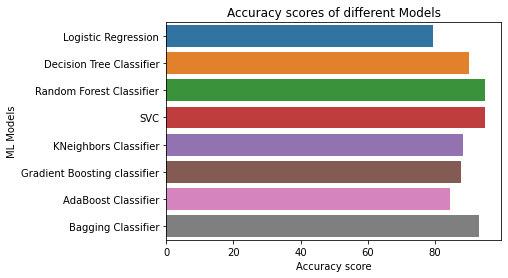

In [ ]:
# Checking the accuracy of models

score_lr= 79.39983779399837
score_dt= 89.9837793998378
score_rf= 94.64720194647201
score_svc= 94.566098945661
score_knc= 88.64557988645579

score_gb= 87.95620437956204
score_ada= 84.54987834549878
score_bag= 93.26845093268452


acc_result=[score_lr,score_dt,score_rf,score_svc,score_knc,score_gb,score_ada,score_bag]
acc_results = pd.DataFrame({"Accuracy Scores":acc_result, "ML Models":[ "Logistic Regression",
            "Decision Tree Classifier","Random Forest Classifier", "SVC","KNeighbors Classifier",
            "Gradient Boosting classifier","AdaBoost Classifier", "Bagging Classifier"]})

g = sns.barplot("Accuracy Scores", "ML Models", data = acc_results)
g.set_xlabel("Accuracy score")
g.set_title("Accuracy scores of different Models")

Text(0.5, 1.0, 'Cross Validation Scores')

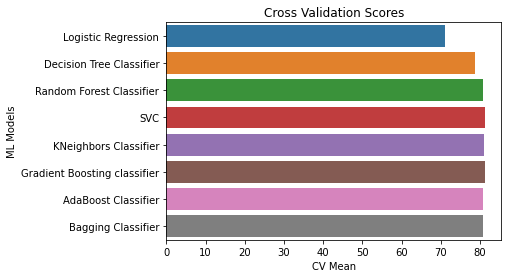

In [ ]:
# Checking the cvscore of models

cvscore_lr= 71.04622871046229
cvscore_dt= 78.73479318734795
cvscore_rf= 80.8515815085158
cvscore_svc= 81.28142741281428
cvscore_knc= 81.08678021086779

cvscore_gb= 81.16788321167883
cvscore_ada= 80.77047850770478
cvscore_bag= 80.72992700729927

cv_result=[cvscore_lr,cvscore_dt,cvscore_rf,cvscore_svc,cvscore_knc,cvscore_gb,cvscore_ada,cvscore_bag]
cv_results = pd.DataFrame({"Cross Validation Means":cv_result, "ML Models":[ "Logistic Regression",
            "Decision Tree Classifier","Random Forest Classifier", "SVC","KNeighbors Classifier",
            "Gradient Boosting classifier","AdaBoost Classifier", "Bagging Classifier"]})

g = sns.barplot("Cross Validation Means", "ML Models", data = cv_results)
g.set_xlabel("CV Mean")
g.set_title("Cross Validation Scores")

In [ ]:
# From above clearly Support Vector Classifier has the highest accuracy cv score

In [ ]:
# Let us now check the AUC and ROC

In [ ]:
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.metrics import plot_roc_curve

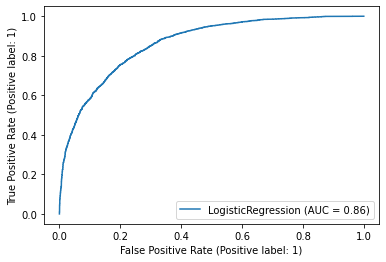

In [ ]:
disp= plot_roc_curve(lr, X_train, y_train)

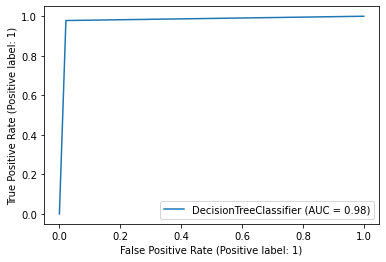

In [ ]:
disp= plot_roc_curve(dt, X_train, y_train)

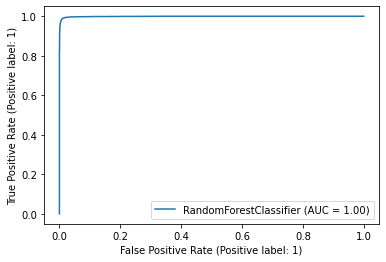

In [ ]:
disp= plot_roc_curve(rf, X_train, y_train)

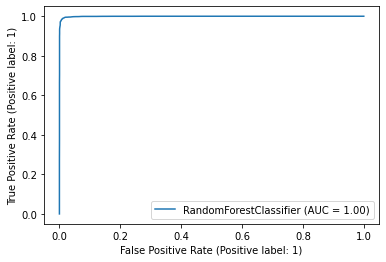

In [ ]:
disp= plot_roc_curve(svc, X_train, y_train)

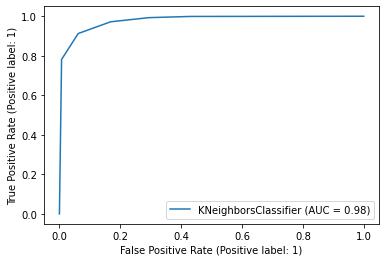

In [ ]:
disp= plot_roc_curve(knc, X_train, y_train)

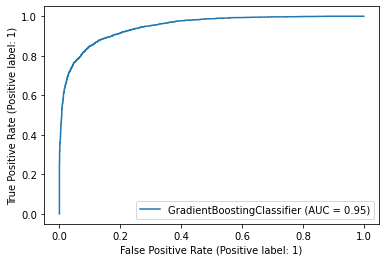

In [ ]:
disp= plot_roc_curve(gb, X_train, y_train)

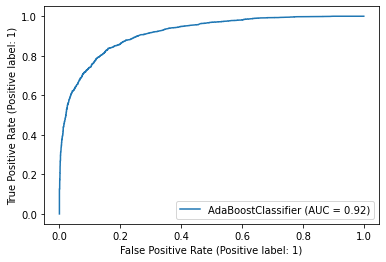

In [ ]:
disp= plot_roc_curve(ada, X_train, y_train)

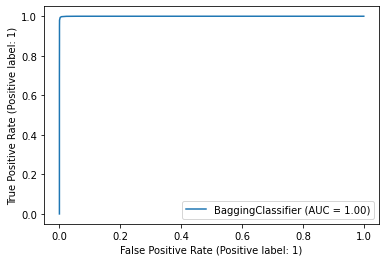

In [ ]:
disp= plot_roc_curve(bag, X_train, y_train)

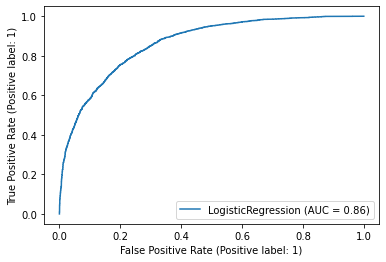

In [ ]:
disp= plot_roc_curve(lr, X_train, y_train)

In [ ]:
# considering all the above models, we can conclude Support Vector Classifier are the best model for our problem.
# Let us proceed with this model...

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 175)

# Training the model
svc.fit(X_train, y_train)
    
# Predicting Y_test
pred = svc.predict(X_test)
    
# Accuracy Score
acc_score = (accuracy_score(y_test, pred))*100
print("Accuracy Score:", acc_score)
    
# Classification Report
class_report = classification_report(y_test, pred)
print("\nClassification Report:\n", class_report)
    
# Cross Validation Score
cv_score = (cross_val_score(svc, X, y, cv=5).mean())*100
print("Cross Validation Score:", cv_score)
    
# Result of accuracy minus cv scores
result = acc_score - cv_score
print("\nAccuracy Score - Cross Validation Score is", abs(result))

Accuracy Score: 93.83617193836173

Classification Report:
               precision    recall  f1-score   support

           0       0.95      0.93      0.94      1279
           1       0.93      0.94      0.94      1187

    accuracy                           0.94      2466
   macro avg       0.94      0.94      0.94      2466
weighted avg       0.94      0.94      0.94      2466

Cross Validation Score: 80.73803730738037

Accuracy Score - Cross Validation Score is 13.098134630981363


In [ ]:
# check train and test score for Random Forest
y_pred= svc.predict(X_train)
pred= svc.predict(X_test)
train_result= accuracy_score(y_train, y_pred)*100
test_result= accuracy_score(y_test, pred)*100

In [ ]:
train_result

100.0

In [ ]:
test_result

93.83617193836173

In [ ]:
# Hyperparameter tuning for SVC

from sklearn.model_selection import GridSearchCV

params={'C': [0.1, 1, 10, 100, 1000],
              'gamma': [1, 0.1, 0.01, 0.001, 0.0001],
              'kernel': ['rbf']}

svc2= SVC()

svcgrid=GridSearchCV(svc2,param_grid=params,scoring='accuracy',cv=5)
svcgrid.fit(X_train,y_train)  
      
print(svcgrid.best_params_)

{'C': 10, 'gamma': 0.1, 'kernel': 'rbf'}


In [ ]:
svc2= SVC(C= 10, gamma= 0.1, kernel= 'rbf')
svc2.fit(X_train, y_train)
svc2.score(X_train, y_train)
pred_decision= svc2.predict(X_test)

# Accuracy Score
acc_score = (accuracy_score(y_test, pred_decision))*100
print("Accuracy Score:", acc_score)
    
# Classification Report
class_report = classification_report(y_test, pred_decision)
print("\nClassification Report:\n", class_report)
    
# Cross Validation Score
cv_score = (cross_val_score(svc2, X, y, cv=5).mean())*100
print("Cross Validation Score:", cv_score)
    
# Result of accuracy minus cv scores
result = acc_score - cv_score
print("\nAccuracy Score - Cross Validation Score is", result)

Accuracy Score: 94.64720194647201

Classification Report:
               precision    recall  f1-score   support

           0       0.98      0.92      0.95      1279
           1       0.92      0.98      0.95      1187

    accuracy                           0.95      2466
   macro avg       0.95      0.95      0.95      2466
weighted avg       0.95      0.95      0.95      2466

Cross Validation Score: 82.42497972424981

Accuracy Score - Cross Validation Score is 12.2222222222222


In [ ]:
# Slight increase in accuracy and performance!
# So we choose SVC as our final model...

In [ ]:
# Conclusion

In [ ]:
import pickle
filename= 'churn.pkl'
pickle.dump(svc2, open(filename, 'wb'))

In [ ]:
[]

[]

In [ ]:
loaded_model=pickle.load(open('churn.pkl','rb'))
result= loaded_model.score(X_test, y_test)
print(result*100)

94.64720194647201


In [ ]:
conclusion= pd.DataFrame([loaded_model.predict(X_test)[:],pred_decision[:]], index=['Predicted','Original'])

In [ ]:
conclusion

,0,1,2,3,4,5,6,7,8,9,...,2456,2457,2458,2459,2460,2461,2462,2463,2464,2465
Predicted,0,0,1,1,0,1,1,1,0,0,...,1,0,0,1,1,1,0,1,1,1
Original,0,0,1,1,0,1,1,1,0,0,...,1,0,0,1,1,1,0,1,1,1


The accuracy score for prediction of RainTomorrow is 95%

# Prediction:

2. Rainfall

In [ ]:
# Train-Test split

X = df.drop('Rainfall', axis=1)
y = df['Rainfall']

In [ ]:
X

,Location,MinTemp,MaxTemp,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,...,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Year,Month,Day
0,1,13.4,22.900000,0.033069,0.068796,13,0.448790,13,14,0.785250,...,1007.1,8.000000,4.503183,16.9,21.8,0,0,2008,12,1
1,1,7.4,25.100000,0.033069,0.068796,14,0.448790,6,15,-0.982717,...,1007.8,4.566622,4.503183,17.2,24.3,0,0,2008,12,2
2,1,12.9,25.700000,0.033069,0.068796,15,0.593637,13,15,0.701237,...,1008.7,4.566622,2.000000,21.0,23.2,0,0,2008,12,3
3,1,9.2,28.000000,0.033069,0.068796,4,-1.250093,9,0,-0.062332,...,1012.8,4.566622,4.503183,18.1,26.5,0,0,2008,12,4
4,1,17.5,32.300000,0.033069,0.068796,13,0.224831,1,7,-0.540338,...,1006.0,7.000000,8.000000,17.8,29.7,0,0,2008,12,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,9,2.8,23.400000,0.033069,0.068796,0,-0.591948,9,1,0.147286,...,1020.3,4.566622,4.503183,10.1,22.4,0,0,2017,6,21
8421,9,3.6,25.300000,0.033069,0.068796,6,-1.456067,9,3,0.147286,...,1019.1,4.566622,4.503183,10.9,24.5,0,0,2017,6,22
8422,9,5.4,26.900000,0.033069,0.068796,3,-0.087700,9,14,-0.289675,...,1016.8,4.566622,4.503183,12.5,26.1,0,0,2017,6,23
8423,9,7.8,27.000000,0.033069,0.068796,9,-0.863369,10,3,0.147286,...,1016.5,3.000000,2.000000,15.1,26.0,0,0,2017,6,24


In [ ]:
y

0       1.389009
1      -0.710194
2      -0.710194
3      -0.710194
4       1.424464
          ...   
8420   -0.710194
8421   -0.710194
8422   -0.710194
8423   -0.710194
8424   -0.710194
Name: Rainfall, Length: 7987, dtype: float64

In [ ]:
# VIF to check multicolinearity

In [ ]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X = pd.DataFrame(scaler.fit_transform(X), columns=X.columns)
X

,Location,MinTemp,MaxTemp,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,...,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Year,Month,Day
0,-1.508427,0.056444,-0.145732,0.033069,0.068796,1.229267,0.448790,1.250245,1.400214,0.785250,...,-1.398115,1.425345,0.013138,-0.138099,-0.098593,-0.542476,-0.543635,-1.661315,1.634113,-1.671657
1,-1.508427,-1.058476,0.220676,0.033069,0.068796,1.441960,0.448790,-0.277857,1.626597,-0.982717,...,-1.279988,0.011773,0.013138,-0.084254,0.329747,-0.542476,-0.543635,-1.661315,1.634113,-1.557976
2,-1.508427,-0.036466,0.320605,0.033069,0.068796,1.654654,0.593637,1.250245,1.626597,0.701237,...,-1.128109,0.011773,-1.076661,0.597788,0.141277,-0.542476,-0.543635,-1.661315,1.634113,-1.444296
3,-1.508427,-0.724000,0.703668,0.033069,0.068796,-0.684977,-1.250093,0.377044,-1.769138,-0.062332,...,-0.436219,0.011773,0.013138,0.077282,0.706687,-0.542476,-0.543635,-1.661315,1.634113,-1.330616
4,-1.508427,0.818306,1.419829,0.033069,0.068796,1.229267,0.224831,-1.369358,-0.184462,-0.540338,...,-1.583744,1.013630,1.535531,0.023437,1.254963,-0.542476,-0.543635,-1.661315,1.634113,-1.216936
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7982,1.029423,-1.913248,-0.062457,0.033069,0.068796,-1.535751,-0.591948,0.377044,-1.542755,0.147286,...,0.829435,0.011773,0.013138,-1.358595,0.004208,-0.542476,-0.543635,2.004134,-0.123726,0.601949
7983,1.029423,-1.764592,0.253986,0.033069,0.068796,-0.259589,-1.456067,0.377044,-1.089991,0.147286,...,0.626930,0.011773,0.013138,-1.215007,0.364014,-0.542476,-0.543635,2.004134,-0.123726,0.715629
7984,1.029423,-1.430116,0.520464,0.033069,0.068796,-0.897670,-0.087700,0.377044,1.400214,-0.289675,...,0.238796,0.011773,0.013138,-0.927832,0.638152,-0.542476,-0.543635,2.004134,-0.123726,0.829310
7985,1.029423,-0.984148,0.537119,0.033069,0.068796,0.378492,-0.863369,0.595344,-1.089991,0.147286,...,0.188170,-0.633229,-1.076661,-0.461172,0.621019,-0.542476,-0.543635,2.004134,-0.123726,0.942990


In [ ]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

In [ ]:
VIF= pd.DataFrame()
VIF['features']= X.columns
VIF['VIF']= [variance_inflation_factor(X.values,i ) for i in range(len(X.columns))]
VIF

,features,VIF
0,Location,1.601767
1,MinTemp,8.843007
2,MaxTemp,26.357127
3,Evaporation,1.650941
4,Sunshine,2.040161
5,WindGustDir,1.615743
6,WindGustSpeed,2.375642
7,WindDir9am,1.362169
8,WindDir3pm,1.488530
9,WindSpeed9am,1.998460


In [ ]:
# Dropping Temp3pm column as it has highest VIF

X= X.drop('Temp3pm',axis=1)

In [ ]:
X

,Location,MinTemp,MaxTemp,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,...,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,RainToday,RainTomorrow,Year,Month,Day
0,-1.508427,0.056444,-0.145732,0.033069,0.068796,1.229267,0.448790,1.250245,1.400214,0.785250,...,-1.687142,-1.398115,1.425345,0.013138,-0.138099,-0.542476,-0.543635,-1.661315,1.634113,-1.671657
1,-1.508427,-1.058476,0.220676,0.033069,0.068796,1.441960,0.448790,-0.277857,1.626597,-0.982717,...,-1.202435,-1.279988,0.011773,0.013138,-0.084254,-0.542476,-0.543635,-1.661315,1.634113,-1.557976
2,-1.508427,-0.036466,0.320605,0.033069,0.068796,1.654654,0.593637,1.250245,1.626597,0.701237,...,-1.703856,-1.128109,0.011773,-1.076661,0.597788,-0.542476,-0.543635,-1.661315,1.634113,-1.444296
3,-1.508427,-0.724000,0.703668,0.033069,0.068796,-0.684977,-1.250093,0.377044,-1.769138,-0.062332,...,-0.032451,-0.436219,0.011773,0.013138,0.077282,-0.542476,-0.543635,-1.661315,1.634113,-1.330616
4,-1.508427,0.818306,1.419829,0.033069,0.068796,1.229267,0.224831,-1.369358,-0.184462,-0.540338,...,-1.169007,-1.583744,1.013630,1.535531,0.023437,-0.542476,-0.543635,-1.661315,1.634113,-1.216936
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7982,1.029423,-1.913248,-0.062457,0.033069,0.068796,-1.535751,-0.591948,0.377044,-1.542755,0.147286,...,1.137532,0.829435,0.011773,0.013138,-1.358595,-0.542476,-0.543635,2.004134,-0.123726,0.601949
7983,1.029423,-1.764592,0.253986,0.033069,0.068796,-0.259589,-1.456067,0.377044,-1.089991,0.147286,...,0.953678,0.626930,0.011773,0.013138,-1.215007,-0.542476,-0.543635,2.004134,-0.123726,0.715629
7984,1.029423,-1.430116,0.520464,0.033069,0.068796,-0.897670,-0.087700,0.377044,1.400214,-0.289675,...,0.535827,0.238796,0.011773,0.013138,-0.927832,-0.542476,-0.543635,2.004134,-0.123726,0.829310
7985,1.029423,-0.984148,0.537119,0.033069,0.068796,0.378492,-0.863369,0.595344,-1.089991,0.147286,...,0.268402,0.188170,-0.633229,-1.076661,-0.461172,-0.542476,-0.543635,2.004134,-0.123726,0.942990


In [ ]:
# let's check again

In [ ]:
VIF= pd.DataFrame()
VIF['features']= X.columns
VIF['VIF']= [variance_inflation_factor(X.values,i ) for i in range(len(X.columns))]
VIF

,features,VIF
0,Location,1.601061
1,MinTemp,8.798230
2,MaxTemp,9.642555
3,Evaporation,1.650903
4,Sunshine,2.038904
5,WindGustDir,1.612430
6,WindGustSpeed,2.365901
7,WindDir9am,1.361147
8,WindDir3pm,1.487577
9,WindSpeed9am,1.998399


In [ ]:
# Dropping Pressure9am column as it has highest VIF

X= X.drop('Pressure9am',axis=1)

In [ ]:
VIF= pd.DataFrame()
VIF['features']= X.columns
VIF['VIF']= [variance_inflation_factor(X.values,i ) for i in range(len(X.columns))]
VIF

,features,VIF
0,Location,1.601050
1,MinTemp,8.677100
2,MaxTemp,9.259554
3,Evaporation,1.633936
4,Sunshine,2.030112
5,WindGustDir,1.598311
6,WindGustSpeed,2.340139
7,WindDir9am,1.339578
8,WindDir3pm,1.419221
9,WindSpeed9am,1.994322


In [ ]:
# Dropping Temp9am column as it has highest VIF

X= X.drop('Temp9am',axis=1)

In [ ]:
VIF= pd.DataFrame()
VIF['features']= X.columns
VIF['VIF']= [variance_inflation_factor(X.values,i ) for i in range(len(X.columns))]
VIF

,features,VIF
0,Location,1.598776
1,MinTemp,4.561143
2,MaxTemp,5.489924
3,Evaporation,1.630533
4,Sunshine,2.025766
5,WindGustDir,1.596137
6,WindGustSpeed,2.301528
7,WindDir9am,1.339390
8,WindDir3pm,1.418778
9,WindSpeed9am,1.973589


In [ ]:
# Multicolinearity is solved as each of the avobe values are below 10.

In [ ]:
X

,Location,MinTemp,MaxTemp,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,...,Humidity9am,Humidity3pm,Pressure3pm,Cloud9am,Cloud3pm,RainToday,RainTomorrow,Year,Month,Day
0,-1.508427,0.056444,-0.145732,0.033069,0.068796,1.229267,0.448790,1.250245,1.400214,0.785250,...,0.184123,-1.624174,-1.398115,1.425345,0.013138,-0.542476,-0.543635,-1.661315,1.634113,-1.671657
1,-1.508427,-1.058476,0.220676,0.033069,0.068796,1.441960,0.448790,-0.277857,1.626597,-0.982717,...,-1.455097,-1.457752,-1.279988,0.011773,0.013138,-0.542476,-0.543635,-1.661315,1.634113,-1.557976
2,-1.508427,-0.036466,0.320605,0.033069,0.068796,1.654654,0.593637,1.250245,1.626597,0.701237,...,-1.819368,-1.180382,-1.128109,0.011773,-1.076661,-0.542476,-0.543635,-1.661315,1.634113,-1.444296
3,-1.508427,-0.724000,0.703668,0.033069,0.068796,-0.684977,-1.250093,0.377044,-1.769138,-0.062332,...,-1.394385,-1.957019,-0.436219,0.011773,0.013138,-0.542476,-0.543635,-1.661315,1.634113,-1.330616
4,-1.508427,0.818306,1.419829,0.033069,0.068796,1.229267,0.224831,-1.369358,-0.184462,-0.540338,...,0.851954,-1.013959,-1.583744,1.013630,1.535531,-0.542476,-0.543635,-1.661315,1.634113,-1.216936
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7982,1.029423,-1.913248,-0.062457,0.033069,0.068796,-1.535751,-0.591948,0.377044,-1.542755,0.147286,...,-1.030114,-1.513226,0.829435,0.011773,0.013138,-0.542476,-0.543635,2.004134,-0.123726,0.601949
7983,1.029423,-1.764592,0.253986,0.033069,0.068796,-0.259589,-1.456067,0.377044,-1.089991,0.147286,...,-0.726555,-1.679648,0.626930,0.011773,0.013138,-0.542476,-0.543635,2.004134,-0.123726,0.715629
7984,1.029423,-1.430116,0.520464,0.033069,0.068796,-0.897670,-0.087700,0.377044,1.400214,-0.289675,...,-0.908690,-1.513226,0.238796,0.011773,0.013138,-0.542476,-0.543635,2.004134,-0.123726,0.829310
7985,1.029423,-0.984148,0.537119,0.033069,0.068796,0.378492,-0.863369,0.595344,-1.089991,0.147286,...,-1.030114,-1.513226,0.188170,-0.633229,-1.076661,-0.542476,-0.543635,2.004134,-0.123726,0.942990


In [ ]:
y

0       1.389009
1      -0.710194
2      -0.710194
3      -0.710194
4       1.424464
          ...   
8420   -0.710194
8421   -0.710194
8422   -0.710194
8423   -0.710194
8424   -0.710194
Name: Rainfall, Length: 7987, dtype: float64

In [ ]:
# Modelling

from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsRegressor
from sklearn.linear_model import Ridge, Lasso
from sklearn.metrics import r2_score
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.model_selection import cross_val_score

# machine learning models

lr= LinearRegression()
dt= DecisionTreeRegressor()
rf= RandomForestRegressor()
svr= SVR()
knn= KNeighborsRegressor(n_neighbors =4)
rd= Ridge()
ls= Lasso()

In [ ]:
# LinearRegression

In [ ]:
# finding best random states

maxAccu= 0
maxRS= 0
for i in range(0,100):
    X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.22,random_state=i)
    lr.fit(X_train,y_train)
    lr_predict_train=lr.predict(X_train)
    lr_predict_test=lr.predict(X_test)
    print('At random state', {i}, 'The training accuracy is :', r2_score(y_train,lr_predict_train))
    print('At random state', {i}, 'The test accuracy is :', r2_score(y_test,lr_predict_test))
    print('\n')
    
    if r2_score(y_test,lr_predict_test)> maxAccu:
        maxAccu=r2_score(y_test,lr_predict_test)
        maxRS= i
        print('max_accuracy', maxAccu, 'max_random_state', i)

At random state {0} The training accuracy is : 0.6652917978749397
At random state {0} The test accuracy is : 0.6250506171567136


max_accuracy 0.6250506171567136 max_random_state 0
At random state {1} The training accuracy is : 0.6527254848490138
At random state {1} The test accuracy is : 0.669677360992087


max_accuracy 0.669677360992087 max_random_state 1
At random state {2} The training accuracy is : 0.6525223982202764
At random state {2} The test accuracy is : 0.6710373797821259


max_accuracy 0.6710373797821259 max_random_state 2
At random state {3} The training accuracy is : 0.6588842305467705
At random state {3} The test accuracy is : 0.6477642368469282


At random state {4} The training accuracy is : 0.6555907961116335
At random state {4} The test accuracy is : 0.6599498866841018


At random state {5} The training accuracy is : 0.6569522458533569
At random state {5} The test accuracy is : 0.6557576874756506


At random state {6} The training accuracy is : 0.6562604528272566
At 

In [ ]:
print('best accuracy is', maxAccu, 'on random_state', maxRS)

best accuracy is 0.691525516640225 on random_state 76


In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state=maxRS)

lr.fit(X_train, y_train)
y_train_pred = lr.predict(X_train)
y_test_pred = lr.predict(X_test)

#mean_squared_error of train set
s = mean_squared_error(y_train, y_train_pred)
print('Mean Squared error of training set :%2f'%s)

#mean_squared_error of test set
p = mean_squared_error(y_test, y_test_pred)
print('Mean Squared error of testing set :%2f'%p)

# R2 score
s = r2_score(y_train, y_train_pred)
print('R2 Score of training set:%.2f'%s)

p = r2_score(y_test, y_test_pred)
print('R2 Score of testing set:%.2f'%p)

lrscore= cross_val_score(lr, X, y, cv=5)
lrc= lrscore.mean()
print('Cross Val Score:', lrc*100)

print('difference of cross-validation and R2 score is:%.2f'%abs(lrc*100- r2_score(y_test, y_test_pred)*100))

Mean Squared error of training set :0.351391
Mean Squared error of testing set :0.310732
R2 Score of training set:0.65
R2 Score of testing set:0.70
Cross Val Score: 65.03986440262935
difference of cross-validation and R2 score is:4.47


In [ ]:
# DecisionTreeRegressor

In [ ]:
# finding best random states

maxAccu= 0
maxRS= 0
for i in range(0,100):
    X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.22,random_state=i)
    dt.fit(X_train,y_train)
    dt_predict_train=dt.predict(X_train)
    dt_predict_test=dt.predict(X_test)
    print('At random state', {i}, 'The training accuracy is :', r2_score(y_train,dt_predict_train))
    print('At random state', {i}, 'The test accuracy is :', r2_score(y_test,dt_predict_test))
    print('\n')
    
    if r2_score(y_test,dt_predict_test)> maxAccu:
        maxAccu=r2_score(y_test,dt_predict_test)
        maxRS= i
        print('max_accuracy', maxAccu, 'max_random_state', i)

At random state {0} The training accuracy is : 1.0
At random state {0} The test accuracy is : 0.5348702876222834


max_accuracy 0.5348702876222834 max_random_state 0
At random state {1} The training accuracy is : 1.0
At random state {1} The test accuracy is : 0.5241419979097638


At random state {2} The training accuracy is : 1.0
At random state {2} The test accuracy is : 0.5540245483815864


max_accuracy 0.5540245483815864 max_random_state 2
At random state {3} The training accuracy is : 1.0
At random state {3} The test accuracy is : 0.538746760690638


At random state {4} The training accuracy is : 1.0
At random state {4} The test accuracy is : 0.5670201664274727


max_accuracy 0.5670201664274727 max_random_state 4
At random state {5} The training accuracy is : 1.0
At random state {5} The test accuracy is : 0.5452282124856849


At random state {6} The training accuracy is : 1.0
At random state {6} The test accuracy is : 0.5071125147168334


At random state {7} The training accuracy i

In [ ]:
print('best accuracy is', maxAccu, 'on random_state', maxRS)

best accuracy is 0.6112396581022339 on random_state 96


In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state= maxRS)

dt.fit(X_train, y_train)
y_train_pred = dt.predict(X_train)
y_test_pred = dt.predict(X_test)

#mean_squared_error of train set
s = mean_squared_error(y_train, y_train_pred)
print('Mean Squared error of training set :%2f'%s)

#mean_squared_error of test set
p = mean_squared_error(y_test, y_test_pred)
print('Mean Squared error of testing set :%2f'%p)

# R2 score
s = r2_score(y_train, y_train_pred)
print('R2 Score of training set:%.2f'%s)

p = r2_score(y_test, y_test_pred)
print('R2 Score of testing set:%.2f'%p)

dtscore= cross_val_score(dt, X, y, cv=5)
dtc= dtscore.mean()
print('Cross Val Score:', dtc*100)

print('difference of cross-validation and R2 score is:%.2f'%abs(dtc*100- r2_score(y_test, y_test_pred)*100))

Mean Squared error of training set :0.000000
Mean Squared error of testing set :0.399960
R2 Score of training set:1.00
R2 Score of testing set:0.60
Cross Val Score: 46.70931813362845
difference of cross-validation and R2 score is:13.47


In [ ]:
# RandomForestRegressor

In [ ]:
# finding best random states

maxAccu= 0
maxRS= 0
for i in range(0,100):
    X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.22,random_state=i)
    rf.fit(X_train,y_train)
    rf_predict_train=rf.predict(X_train)
    rf_predict_test=rf.predict(X_test)
    print('At random state', {i}, 'The training accuracy is :', r2_score(y_train,rf_predict_train))
    print('At random state', {i}, 'The test accuracy is :', r2_score(y_test,rf_predict_test))
    print('\n')
    
    if r2_score(y_test,rf_predict_test)> maxAccu:
        maxAccu=r2_score(y_test,rf_predict_test)
        maxRS= i
        print('max_accuracy', maxAccu, 'max_random_state', i)

At random state {0} The training accuracy is : 0.9652701112367825
At random state {0} The test accuracy is : 0.7313682951671433


max_accuracy 0.7313682951671433 max_random_state 0
At random state {1} The training accuracy is : 0.9645486011492822
At random state {1} The test accuracy is : 0.7638354742149294


max_accuracy 0.7638354742149294 max_random_state 1
At random state {2} The training accuracy is : 0.9642232060279299
At random state {2} The test accuracy is : 0.748506483906837


At random state {3} The training accuracy is : 0.9654550908944043
At random state {3} The test accuracy is : 0.74417869891878


At random state {4} The training accuracy is : 0.9647332449246618
At random state {4} The test accuracy is : 0.7617025181184165


At random state {5} The training accuracy is : 0.9647533925321073
At random state {5} The test accuracy is : 0.7503738261953465


At random state {6} The training accuracy is : 0.9655560846513735
At random state {6} The test accuracy is : 0.7606182950

In [ ]:
print('best accuracy is', maxAccu, 'on random_state', maxRS)

best accuracy is 0.7798723871678335 on random_state 96


In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state= maxRS)

rf.fit(X_train, y_train)
y_train_pred = rf.predict(X_train)
y_test_pred = rf.predict(X_test)

#mean_squared_error of train set
s = mean_squared_error(y_train, y_train_pred)
print('Mean Squared error of training set :%2f'%s)

#mean_squared_error of test set
p = mean_squared_error(y_test, y_test_pred)
print('Mean Squared error of testing set :%2f'%p)

# R2 score
s = r2_score(y_train, y_train_pred)
print('R2 Score of training set:%.2f'%s)

p = r2_score(y_test, y_test_pred)
print('R2 Score of testing set:%.2f'%p)

rfscore= cross_val_score(rf, X, y, cv=5)
rfc= rfscore.mean()
print('Cross Val Score:', rfc*100)

print('difference of cross-validation and R2 score is:%.2f'%abs(rfc*100- r2_score(y_test, y_test_pred)*100))

Mean Squared error of training set :0.036096
Mean Squared error of testing set :0.217066
R2 Score of training set:0.96
R2 Score of testing set:0.78
Cross Val Score: 71.30163990413647
difference of cross-validation and R2 score is:7.09


In [ ]:
# SVR

In [ ]:
# finding best random states

maxAccu= 0
maxRS= 0
for i in range(0,100):
    X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.22,random_state=i)
    svr.fit(X_train,y_train)
    svr_predict_train=svr.predict(X_train)
    svr_predict_test=svr.predict(X_test)
    print('At random state', {i}, 'The training accuracy is :', r2_score(y_train,svr_predict_train))
    print('At random state', {i}, 'The test accuracy is :', r2_score(y_test,svr_predict_test))
    print('\n')
    
    if r2_score(y_test,svr_predict_test)> maxAccu:
        maxAccu=r2_score(y_test,svr_predict_test)
        maxRS= i
        print('max_accuracy', maxAccu, 'max_random_state', i)

At random state {0} The training accuracy is : 0.7086706136618953
At random state {0} The test accuracy is : 0.6128720148099961


max_accuracy 0.6128720148099961 max_random_state 0
At random state {1} The training accuracy is : 0.695742327599231
At random state {1} The test accuracy is : 0.6621590574843834


max_accuracy 0.6621590574843834 max_random_state 1
At random state {2} The training accuracy is : 0.6978245167977739
At random state {2} The test accuracy is : 0.6684016618884807


max_accuracy 0.6684016618884807 max_random_state 2
At random state {3} The training accuracy is : 0.7015267965682888
At random state {3} The test accuracy is : 0.6446683895670223


At random state {4} The training accuracy is : 0.6991616685021604
At random state {4} The test accuracy is : 0.6609846627903148


At random state {5} The training accuracy is : 0.7022948514212966
At random state {5} The test accuracy is : 0.6498836882537871


At random state {6} The training accuracy is : 0.6954723817439672
At

In [ ]:
print('best accuracy is', maxAccu, 'on random_state', maxRS)

best accuracy is 0.6923478016286058 on random_state 99


In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state= maxRS)

svr.fit(X_train, y_train)
y_train_pred = svr.predict(X_train)
y_test_pred = svr.predict(X_test)

#mean_squared_error of train set
s = mean_squared_error(y_train, y_train_pred)
print('Mean Squared error of training set :%2f'%s)

#mean_squared_error of test set
p = mean_squared_error(y_test, y_test_pred)
print('Mean Squared error of testing set :%2f'%p)

# R2 score
s = r2_score(y_train, y_train_pred)
print('R2 Score of training set:%.2f'%s)

p = r2_score(y_test, y_test_pred)
print('R2 Score of testing set:%.2f'%p)

svrscore= cross_val_score(svr, X, y, cv=5)
svrc= svrscore.mean()
print('Cross Val Score:', svrc*100)

print('difference of cross-validation and R2 score is:%.2f'%abs(svrc*100- r2_score(y_test, y_test_pred)*100))

Mean Squared error of training set :0.310902
Mean Squared error of testing set :0.301929
R2 Score of training set:0.69
R2 Score of testing set:0.70
Cross Val Score: 63.592823543039756
difference of cross-validation and R2 score is:6.27


In [ ]:
# KNeighborsRegressor

In [ ]:
# finding best random states

maxAccu= 0
maxRS= 0
for i in range(0,100):
    X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.22,random_state=i)
    knn.fit(X_train,y_train)
    knn_predict_train=knn.predict(X_train)
    knn_predict_test=knn.predict(X_test)
    print('At random state', {i}, 'The training accuracy is :', r2_score(y_train,knn_predict_train))
    print('At random state', {i}, 'The test accuracy is :', r2_score(y_test,knn_predict_test))
    print('\n')
    
    if r2_score(y_test,knn_predict_test)> maxAccu:
        maxAccu=r2_score(y_test,knn_predict_test)
        maxRS= i
        print('max_accuracy', maxAccu, 'max_random_state', i)

At random state {0} The training accuracy is : 0.7837635570172574
At random state {0} The test accuracy is : 0.5625360558394223


max_accuracy 0.5625360558394223 max_random_state 0
At random state {1} The training accuracy is : 0.7680476461625099
At random state {1} The test accuracy is : 0.6218566623563415


max_accuracy 0.6218566623563415 max_random_state 1
At random state {2} The training accuracy is : 0.7739394884149144
At random state {2} The test accuracy is : 0.6063862517566696


At random state {3} The training accuracy is : 0.7761878623112497
At random state {3} The test accuracy is : 0.5985838266914347


At random state {4} The training accuracy is : 0.7708938082424995
At random state {4} The test accuracy is : 0.6115536093875471


At random state {5} The training accuracy is : 0.7747895112606747
At random state {5} The test accuracy is : 0.6139491426042614


At random state {6} The training accuracy is : 0.7700928178689572
At random state {6} The test accuracy is : 0.6335085

In [ ]:
print('best accuracy is', maxAccu, 'on random_state', maxRS)

best accuracy is 0.6442038823353355 on random_state 99


In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state= 57)

knn.fit(X_train, y_train)
y_train_pred = knn.predict(X_train)
y_test_pred = knn.predict(X_test)

#mean_squared_error of train set
s = mean_squared_error(y_train, y_train_pred)
print('Mean Squared error of training set :%2f'%s)

#mean_squared_error of test set
p = mean_squared_error(y_test, y_test_pred)
print('Mean Squared error of testing set :%2f'%p)

# R2 score
s = r2_score(y_train, y_train_pred)
print('R2 Score of training set:%.2f'%s)

p = r2_score(y_test, y_test_pred)
print('R2 Score of testing set:%.2f'%p)

knnscore= cross_val_score(knn, X, y, cv=5)
knnc= knnscore.mean()
print('Cross Val Score:', knnc*100)

print('difference of cross-validation and R2 score is:%.2f'%abs(knnc*100- r2_score(y_test, y_test_pred)*100))

Mean Squared error of training set :0.222464
Mean Squared error of testing set :0.426679
R2 Score of training set:0.78
R2 Score of testing set:0.57
Cross Val Score: 57.411807305338925
difference of cross-validation and R2 score is:0.18


In [ ]:
# Ridge

In [ ]:
# finding best random states

maxAccu= 0
maxRS= 0
for i in range(0,100):
    X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.22,random_state=i)
    rd.fit(X_train,y_train)
    rd_predict_train=rd.predict(X_train)
    rd_predict_test=rd.predict(X_test)
    print('At random state', {i}, 'The training accuracy is :', r2_score(y_train,rd_predict_train))
    print('At random state', {i}, 'The test accuracy is :', r2_score(y_test,rd_predict_test))
    print('\n')
    
    if r2_score(y_test,rd_predict_test)> maxAccu:
        maxAccu=r2_score(y_test,rd_predict_test)
        maxRS= i
        print('max_accuracy', maxAccu, 'max_random_state', i)

At random state {0} The training accuracy is : 0.665291779137374
At random state {0} The test accuracy is : 0.6250536738957735


max_accuracy 0.6250536738957735 max_random_state 0
At random state {1} The training accuracy is : 0.6527254647881608
At random state {1} The test accuracy is : 0.6696790989551722


max_accuracy 0.6696790989551722 max_random_state 1
At random state {2} The training accuracy is : 0.6525223802732428
At random state {2} The test accuracy is : 0.6710328430161641


max_accuracy 0.6710328430161641 max_random_state 2
At random state {3} The training accuracy is : 0.6588842112760973
At random state {3} The test accuracy is : 0.6477629110944219


At random state {4} The training accuracy is : 0.6555907768174055
At random state {4} The test accuracy is : 0.6599513653567392


At random state {5} The training accuracy is : 0.6569522266339943
At random state {5} The test accuracy is : 0.6557554207620386


At random state {6} The training accuracy is : 0.6562604320756402
At

In [ ]:
print('best accuracy is', maxAccu, 'on random_state', maxRS)

best accuracy is 0.6915252504857766 on random_state 76


In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state= 26)

rd.fit(X_train, y_train)
y_train_pred = rd.predict(X_train)
y_test_pred = rd.predict(X_test)

#mean_squared_error of train set
s = mean_squared_error(y_train, y_train_pred)
print('Mean Squared error of training set :%2f'%s)

#mean_squared_error of test set
p = mean_squared_error(y_test, y_test_pred)
print('Mean Squared error of testing set :%2f'%p)

# R2 score
s = r2_score(y_train, y_train_pred)
print('R2 Score of training set:%.2f'%s)

p = r2_score(y_test, y_test_pred)
print('R2 Score of testing set:%.2f'%p)

rdscore= cross_val_score(rd, X, y, cv=5)
rdc= rdscore.mean()
print('Cross Val Score:', rdc*100)

print('difference of cross-validation and R2 score is:%.2f'%abs(rdc*100- r2_score(y_test, y_test_pred)*100))

Mean Squared error of training set :0.346391
Mean Squared error of testing set :0.331841
R2 Score of training set:0.66
R2 Score of testing set:0.66
Cross Val Score: 65.03993448418287
difference of cross-validation and R2 score is:0.55


In [ ]:
# Lasso

In [ ]:
# finding best random states

maxAccu= 0
maxRS= 0
for i in range(0,100):
    X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.22,random_state=i)
    rd.fit(X_train,y_train)
    rd_predict_train=rd.predict(X_train)
    rd_predict_test=rd.predict(X_test)
    print('At random state', {i}, 'The training accuracy is :', r2_score(y_train,rd_predict_train))
    print('At random state', {i}, 'The test accuracy is :', r2_score(y_test,rd_predict_test))
    print('\n')
    
    if r2_score(y_test,rd_predict_test)> maxAccu:
        maxAccu=r2_score(y_test,rd_predict_test)
        maxRS= i
        print('max_accuracy', maxAccu, 'max_random_state', i)

At random state {0} The training accuracy is : 0.665291779137374
At random state {0} The test accuracy is : 0.6250536738957735


max_accuracy 0.6250536738957735 max_random_state 0
At random state {1} The training accuracy is : 0.6527254647881608
At random state {1} The test accuracy is : 0.6696790989551722


max_accuracy 0.6696790989551722 max_random_state 1
At random state {2} The training accuracy is : 0.6525223802732428
At random state {2} The test accuracy is : 0.6710328430161641


max_accuracy 0.6710328430161641 max_random_state 2
At random state {3} The training accuracy is : 0.6588842112760973
At random state {3} The test accuracy is : 0.6477629110944219


At random state {4} The training accuracy is : 0.6555907768174055
At random state {4} The test accuracy is : 0.6599513653567392


At random state {5} The training accuracy is : 0.6569522266339943
At random state {5} The test accuracy is : 0.6557554207620386


At random state {6} The training accuracy is : 0.6562604320756402
At

In [ ]:
print('best accuracy is', maxAccu, 'on random_state', maxRS)

best accuracy is 0.6915252504857766 on random_state 76


In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state= 64)

ls.fit(X_train, y_train)
y_train_pred = ls.predict(X_train)
y_test_pred = ls.predict(X_test)

#mean_squared_error of train set
s = mean_squared_error(y_train, y_train_pred)
print('Mean Squared error of training set :%2f'%s)

#mean_squared_error of test set
p = mean_squared_error(y_test, y_test_pred)
print('Mean Squared error of testing set :%2f'%p)

# R2 score
s = r2_score(y_train, y_train_pred)
print('R2 Score of training set:%.2f'%s)

p = r2_score(y_test, y_test_pred)
print('R2 Score of testing set:%.2f'%p)

lsscore= cross_val_score(ls, X, y, cv=5)
lsc= lsscore.mean()
print('Cross Val Score:', lsc*100)

print('difference of cross-validation and R2 score is:%.2f'%abs(lsc*100- r2_score(y_test, y_test_pred)*100))

Mean Squared error of training set :1.006829
Mean Squared error of testing set :0.973377
R2 Score of training set:0.00
R2 Score of testing set:-0.00
Cross Val Score: -1.8324800309614586
difference of cross-validation and R2 score is:1.48


Text(0.5, 1.0, 'Accuracy scores of different Models')

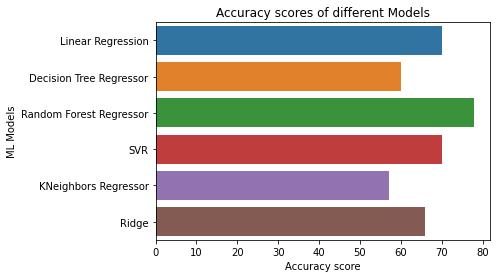

In [ ]:
# Checking the accuracy of models

score_lr= 0.70*100
score_dt= 0.60*100
score_rf= 0.78*100
score_svr= 0.70*100
score_knn= 0.57*100
score_rd= 0.66*100


acc_result=[score_lr,score_dt,score_rf,score_svr,score_knn,score_rd]
acc_results = pd.DataFrame({"Accuracy Scores":acc_result, "ML Models":[ "Linear Regression",
            "Decision Tree Regressor","Random Forest Regressor", "SVR","KNeighbors Regressor",
            "Ridge"]})

g = sns.barplot("Accuracy Scores", "ML Models", data = acc_results)
g.set_xlabel("Accuracy score")
g.set_title("Accuracy scores of different Models")

Text(0.5, 1.0, 'Cross Validation Scores')

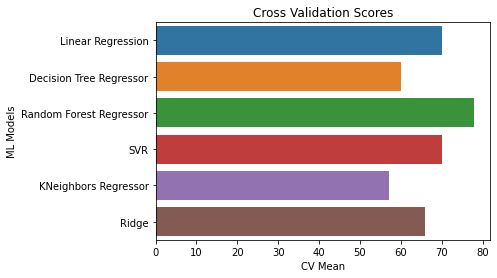

In [ ]:
# Checking the cvscore of models

cvscore_lr= 65.03986440262935
cvscore_dt= 46.70931813362845
cvscore_rf= 71.30163990413647
cvscore_svc= 63.592823543039756
cvscore_knn= 57.411807305338925
cvscore_rd= 65.03993448418287


cv_result=[score_lr,score_dt,score_rf,score_svr,score_knn,score_rd]
cv_results = pd.DataFrame({"Cross Validation Means":cv_result, "ML Models":[ "Linear Regression",
            "Decision Tree Regressor","Random Forest Regressor", "SVR","KNeighbors Regressor",
            "Ridge"]})

g = sns.barplot("Cross Validation Means", "ML Models", data = cv_results)
g.set_xlabel("CV Mean")
g.set_title("Cross Validation Scores")

In [ ]:
# from above it is clear that the best model is RandomForestRegressor and it has the highest efficiency!

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state= 96)

rf.fit(X_train, y_train)
y_train_pred = rf.predict(X_train)
y_test_pred = rf.predict(X_test)

#mean_squared_error of train set
s = mean_squared_error(y_train, y_train_pred)
print('Mean Squared error of training set :%2f'%s)

#mean_squared_error of test set
p = mean_squared_error(y_test, y_test_pred)
print('Mean Squared error of testing set :%2f'%p)

# R2 score
s = r2_score(y_train, y_train_pred)
print('R2 Score of training set:%.2f'%s)

p = r2_score(y_test, y_test_pred)
print('R2 Score of testing set:%.2f'%p)

rfscore= cross_val_score(rf, X, y, cv=5)
rfc= rfscore.mean()
print('Cross Val Score:', rfc*100)

print('difference of cross-validation and R2 score is:%.2f'%abs(rfc*100- r2_score(y_test, y_test_pred)*100))

Mean Squared error of training set :0.036467
Mean Squared error of testing set :0.218899
R2 Score of training set:0.96
R2 Score of testing set:0.78
Cross Val Score: 71.21180852333238
difference of cross-validation and R2 score is:6.99


In [ ]:
# Hyperparameter tuning

In [ ]:
from sklearn.model_selection import GridSearchCV

params={'min_samples_split':[5,10,15,100],
            'n_estimators':[100,200,300,400],
            'max_depth': [5,6,7,8,10,30],
            'max_features':['sqrt','log2',None]}

rfc= RandomForestRegressor()

rfgrid=GridSearchCV(rfc,param_grid=params,scoring='r2',cv=5)
rfgrid.fit(X_train,y_train)  
      
print(rfgrid.best_params_)

{'max_depth': 30, 'max_features': None, 'min_samples_split': 5, 'n_estimators': 300}


In [ ]:
rfc= RandomForestRegressor(min_samples_split= 5, max_depth= 30, max_features= None, n_estimators= 300)
rfc.fit(X_train, y_train)
rfc.score(X_train, y_train)
pred_decision= rfc.predict(X_test)

rfc_s= r2_score(y_test, pred_decision)
print('R2 score:', rfc_s*100)

rfcscore= cross_val_score(rfc, X, y, cv=5)
rfc_c= rfcscore.mean()
print('Cross Val Score:', rfc_c*100)
print('difference of cross-validation and R2 score is:%.2f'%abs(rfc_c*100- r2_score(y_test, pred_decision)*100))

R2 score: 77.87009925762798
Cross Val Score: 71.11229172599384
difference of cross-validation and R2 score is:6.76


In [ ]:
# More or less accuracy and performance!
# We choose Random Forest as our final model...

In [ ]:
# Conclusion

In [ ]:
import pickle
filename= 'churn.pkl'
pickle.dump(rfc, open(filename, 'wb'))

In [ ]:
[]

[]

In [ ]:
loaded_model=pickle.load(open('churn.pkl','rb'))
result= loaded_model.score(X_test, y_test)
print(result*100)

77.87009925762798


In [ ]:
conclusion= pd.DataFrame([loaded_model.predict(X_test)[:],pred_decision[:]], index=['Predicted','Original'])

In [ ]:
conclusion

,0,1,2,3,4,5,6,7,8,9,...,1588,1589,1590,1591,1592,1593,1594,1595,1596,1597
Predicted,-0.337216,-0.708597,-0.624968,-0.585501,1.460514,0.584221,-0.604588,-0.485232,1.459431,1.459058,...,-0.684058,-0.577274,-0.481473,-0.490476,1.453136,-0.211217,-0.674716,-0.078423,-0.56706,-0.492943
Original,-0.337216,-0.708597,-0.624968,-0.585501,1.460514,0.584221,-0.604588,-0.485232,1.459431,1.459058,...,-0.684058,-0.577274,-0.481473,-0.490476,1.453136,-0.211217,-0.674716,-0.078423,-0.56706,-0.492943


# Conclusion:

1) The accuracy score for 'whether or not it will rain tomorrow' is 95%

2) The accuracy score for 'how much rainfall could be there' is 78%

